In [2]:
import pandas as pd
import numpy as np
import time
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import roc_auc_score
from matplotlib import pyplot as plt
from imblearn.over_sampling import SMOTE
import pickle
import datetime

Using TensorFlow backend.


In [3]:
viewLogFile = pd.read_csv('view_log.csv')
itemDataFile = pd.read_csv('item_data.csv')

In [7]:
trainFile = pd.read_csv('train.csv')

In [10]:
min(trainFile['impression_time'])

'2018-11-15 00:00:00'

In [180]:
a = time.time()

In [181]:
time.time() - a

10.739083766937256

In [11]:
viewLogFile[viewLogFile['session_id'] == 6]

,server_time,device_type,session_id,user_id,item_id
147462,2018-10-18 06:13:00,android,6,26277,88834
147465,2018-10-18 06:13:00,android,6,26277,69705
147471,2018-10-18 06:14:00,android,6,26277,77043
147488,2018-10-18 06:15:00,android,6,26277,52141
147508,2018-10-18 06:16:00,android,6,26277,81627
147514,2018-10-18 06:17:00,android,6,26277,112303
147656,2018-10-18 06:28:00,android,6,26277,66583
147674,2018-10-18 06:29:00,android,6,26277,425
147696,2018-10-18 06:30:00,android,6,26277,50360
147728,2018-10-18 06:32:00,android,6,26277,40952


In [6]:
viewLogFile.groupby?

In [8]:
viewLogFile.groupby('session_id')['item_id'].value_counts()

session_id  item_id
0           69585      1
            81804      1
1           17814      1
            82856      1
            89373      1
2           2715       1
4           76404      1
            96237      1
5           79225      1
6           127900     6
            425        1
            40952      1
            50360      1
            52141      1
            61874      1
            66583      1
            69705      1
            76109      1
            77043      1
            81627      1
            88834      1
            112303     1
            130603     1
8           85426      5
            45153      2
            73745      2
            114095     1
9           1786       1
10          17814      1
11          66430      1
                      ..
1089666     126639     2
1089667     56121      1
1089668     30048      1
1089669     66487      2
            109326     2
            25783      1
            34285      1
            39914      1
     

In [12]:
viewLogFile.groupby('user_id')['session_id'].value_counts()

user_id  session_id
0        143955        19
         268465         6
         968970         5
         144465         2
         191704         2
         315626         2
         675965         2
         86373          1
         295495         1
         921046         1
         956652         1
1        757029         6
         63432          1
         116569         1
2        324986        16
         1042179       16
         1083196       11
         152936         9
         247494         9
         451378         9
         499575         8
         538041         8
         520908         7
         758599         6
         269135         5
         950177         5
         334355         4
         371541         4
         1089219        4
         72054          3
                       ..
92578    242472         1
92579    420459         2
         681855         1
         782398         1
         1025017        1
92580    84724          4
         931825   

In [13]:
viewLogFile.groupby('session_id')['user_id'].value_counts()

session_id  user_id
0           19007       2
1           46505       3
2           68605       1
4           26848       2
5           15407       1
6           26277      19
8           74009      10
9           23119       1
10          8978        1
11          88663       1
12          45625       1
13          23651       1
15          21839       7
16          3131        1
17          26904       1
18          30600       4
19          42677       1
20          63826       2
21          81926       1
22          53262       3
23          26678       1
24          83183       3
25          92096       5
26          88064      12
27          57267       1
28          43595       1
29          76904       1
30          78898       2
31          1368        3
32          62038       1
                       ..
1089647     79121       3
1089648     44003      33
1089649     57209       2
1089650     73467       1
1089651     90680       1
1089652     31797       1
1089653     76738 

In [14]:
viewLogFile.groupby(['session_id', 'user_id'])['user_id'].value_counts()

session_id  user_id  user_id
0           19007    19007       2
1           46505    46505       3
2           68605    68605       1
4           26848    26848       2
5           15407    15407       1
6           26277    26277      19
8           74009    74009      10
9           23119    23119       1
10          8978     8978        1
11          88663    88663       1
12          45625    45625       1
13          23651    23651       1
15          21839    21839       7
16          3131     3131        1
17          26904    26904       1
18          30600    30600       4
19          42677    42677       1
20          63826    63826       2
21          81926    81926       1
22          53262    53262       3
23          26678    26678       1
24          83183    83183       3
25          92096    92096       5
26          88064    88064      12
27          57267    57267       1
28          43595    43595       1
29          76904    76904       1
30          78898    78898

In [16]:
viewLogFile.head()

,server_time,device_type,session_id,user_id,item_id
0,2018-10-15 08:58:00,android,112333,4557,32970
1,2018-10-15 08:58:00,android,503590,74788,7640
2,2018-10-15 08:58:00,android,573960,23628,128855
3,2018-10-15 08:58:00,android,121691,2430,12774
4,2018-10-15 08:58:00,android,218564,19227,28296


In [17]:
itemDataFile.head()

,item_id,item_price,category_1,category_2,category_3,product_type
0,26880,4602,11,35,20,3040
1,54939,3513,12,57,85,6822
2,40383,825,17,8,279,1619
3,8777,2355,13,58,189,5264
4,113705,1267,17,39,151,10239


In [19]:
pd.merge?

In [4]:
viewLogItem = pd.merge(viewLogFile, itemDataFile, on = 'item_id')

In [34]:
viewLogItem.sort_values('server_time').head(100)

,server_time,device_type,session_id,user_id,item_id,item_price,category_1,category_2,category_3,product_type
0,2018-10-15 08:58:00,android,112333,4557,32970,54685,16,56,253,3184
2526,2018-10-15 08:58:00,android,121691,2430,12774,904,17,39,252,2740
2718,2018-10-15 08:58:00,android,218564,19227,28296,2304,12,57,54,7422
2720,2018-10-15 08:58:00,android,635314,87387,86660,10304,1,7,300,10149
2934,2018-10-15 08:58:00,android,482459,348,35370,480,0,6,50,1457
3385,2018-10-15 08:58:00,android,218564,19227,100065,1587,4,74,292,1945
3387,2018-10-15 08:58:00,android,947548,30183,86558,9920,13,78,1,5526
3868,2018-10-15 08:58:00,android,941129,31754,127900,3520,1,28,283,908
14970,2018-10-15 08:58:00,android,58445,76152,95823,2112,11,51,290,9780
15364,2018-10-15 08:58:00,android,264366,34712,11871,2547,4,38,62,10412


### Make predictions based on type and categories of product viewed

In [26]:
len(np.unique(viewLogItem['product_type']))

7846

In [27]:
len(np.unique(viewLogItem['category_1']))

17

In [91]:
distinctCategory1 = np.unique(viewLogItem['category_1'])
distinctCategory1

array([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17],
      dtype=int64)

In [28]:
len(np.unique(viewLogItem['category_2']))

79

In [29]:
len(np.unique(viewLogItem['category_3']))

335

In [49]:
viewLogItem[viewLogItem['server_time']< '2018-10-15 08:59:00']

,server_time,device_type,session_id,user_id,item_id,item_price,category_1,category_2,category_3,product_type
0,2018-10-15 08:58:00,android,112333,4557,32970,54685,16,56,253,3184
1301,2018-10-15 08:58:00,android,503590,74788,7640,1376,7,71,228,545
2518,2018-10-15 08:58:00,android,573960,23628,128855,4544,4,38,62,5609
2526,2018-10-15 08:58:00,android,121691,2430,12774,904,17,39,252,2740
2718,2018-10-15 08:58:00,android,218564,19227,28296,2304,12,57,54,7422
2720,2018-10-15 08:58:00,android,635314,87387,86660,10304,1,7,300,10149
2934,2018-10-15 08:58:00,android,482459,348,35370,480,0,6,50,1457
3385,2018-10-15 08:58:00,android,218564,19227,100065,1587,4,74,292,1945
3387,2018-10-15 08:58:00,android,947548,30183,86558,9920,13,78,1,5526
3868,2018-10-15 08:58:00,android,941129,31754,127900,3520,1,28,283,908


In [59]:
viewLogItem[(viewLogItem['server_time'] < '2018-10-15 09:09:00') & (viewLogItem['user_id'] == 348)]

,server_time,device_type,session_id,user_id,item_id,item_price,category_1,category_2,category_3,product_type
2934,2018-10-15 08:58:00,android,482459,348,35370,480,0,6,50,1457
110774,2018-10-15 09:00:00,android,482459,348,18976,633,0,45,73,6448


In [61]:
category_1_dist = viewLogItem[viewLogItem['server_time']< '2018-10-15 09:09:00'].groupby('user_id')['category_1'].value_counts()

In [62]:
category_1_dist.head()

user_id  category_1
348      0             2
697      11            2
         8             1
959      0             2
         10            2
Name: category_1, dtype: int64

In [138]:
for i in category_1_dist.head().iteritems():
    print(i, i[0], "Users:",i[0][0], "Category",i[0][1], "Value", i[1])

((348, 0), 2) (348, 0) Users: 348 Category 0 Value 2
((697, 11), 2) (697, 11) Users: 697 Category 11 Value 2
((697, 8), 1) (697, 8) Users: 697 Category 8 Value 1
((959, 0), 2) (959, 0) Users: 959 Category 0 Value 2
((959, 10), 2) (959, 10) Users: 959 Category 10 Value 2


In [84]:
category_1_dist.shape

(253,)

In [68]:
for i in category_1_dist.head():
    print(category_1_dist[i])

1
1
2
1
1


In [88]:
len(distinctUsers)

89152

In [135]:
distinctUsers

array([    0,     1,     2, ..., 92584, 92585, 92586], dtype=int64)

In [110]:
# list1 = ["user_id"]
# list2 = ["Column_1_"+str(x) for x in distinctCategory1]
# test_a = list1.extend(list2)
# print(list1)

['user_id', 'Column_1_0', 'Column_1_1', 'Column_1_2', 'Column_1_4', 'Column_1_5', 'Column_1_6', 'Column_1_7', 'Column_1_8', 'Column_1_9', 'Column_1_10', 'Column_1_11', 'Column_1_12', 'Column_1_13', 'Column_1_14', 'Column_1_15', 'Column_1_16', 'Column_1_17']


In [172]:
category_1_dist = viewLogItem.groupby('user_id')['category_1'].value_counts()

In [173]:
category_1_dist.shape

(668839,)

In [174]:
# Distribution Of Category_1's for users in viewlog data

category_1_dist = viewLogItem.groupby('user_id')['category_1'].value_counts()
print(category_1_dist.shape)

# Getting distinct users

distinctUsers = np.unique(viewLogItem['user_id'])
print(distinctUsers.shape)

# Creating zero filled numpy arrays for 17 categories

categories_array = np.zeros((len(distinctUsers), 17))
print(categories_array.shape)

# Creating a dataframe using these numpy arrays
list1 = ["Category_1_" + str(x) for x in distinctCategory1]
Columns = ['user_id'] + ["Category_1_" + str(x) for x in distinctCategory1]

# Concatenating the numpy arrays
userFlattenedNPData = np.concatenate((distinctUsers.reshape(-1,1), categories_array), axis = 1)

# Creating a dataframe using the numpy arrays
userFlattenedData = pd.DataFrame(data = userFlattenedNPData, columns=Columns)
print(userFlattenedData.shape)


(668839,)
(89152,)
(89152, 17)
(89152, 18)


In [175]:
userFlattenedData[userFlattenedData['user_id'] == 959].head()

,user_id,Category_1_0,Category_1_1,Category_1_2,Category_1_4,Category_1_5,Category_1_6,Category_1_7,Category_1_8,Category_1_9,Category_1_10,Category_1_11,Category_1_12,Category_1_13,Category_1_14,Category_1_15,Category_1_16,Category_1_17
927,959.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Iterating over the collected log data to fill up the Category values

In [176]:
for i in category_1_dist.head().iteritems():
    print(i, i[0], "Users:",i[0][0], "Category",i[0][1], "Value", i[1])

((0, 14), 9) (0, 14) Users: 0 Category 14 Value 9
((0, 7), 8) (0, 7) Users: 0 Category 7 Value 8
((0, 1), 7) (0, 1) Users: 0 Category 1 Value 7
((0, 17), 7) (0, 17) Users: 0 Category 17 Value 7
((0, 6), 5) (0, 6) Users: 0 Category 6 Value 5


In [189]:
category_1_dist.shape

(668839,)

In [150]:
# category_1_dist = viewLogItem.groupby('user_id')['category_1'].value_counts()
getOutput = viewLogItem.groupby('user_id')['category_1'].value_counts().unstack().fillna(0)

In [16]:
type(getOutput)

pandas.core.frame.DataFrame

In [190]:
counts = 0
print(time.time())
startTime = time.time()
for i in category_1_dist.iteritems():
    if(counts % 100000 == 0):
        print("Start of iteration ", counts, time.time())
    userFlattenedData.loc[userFlattenedData['user_id'] == i[0][0] ,'Category_1_' + str(i[0][1])] = i[1]
#     if(counts == 10):
#         print("End: ",time.time())
    counts += 1
endTime = time.time()
print(time.time())
print("Total time taken: ", (endTime - startTime))

#     print(i, i[0], "Users:",i[0][0], "Category",i[0][1], "Value", i[1])

1567073879.1673188
Start of iteration  0 1567073879.1673188
Start of iteration  100000 1567074379.949725
Start of iteration  200000 1567074884.466351
Start of iteration  300000 1567075390.1758883
Start of iteration  400000 1567075896.7704086
Start of iteration  500000 1567076160.415807
Start of iteration  600000 1567076345.511321
1567076474.2947571
Total time taken:  2595.1274383068085


In [191]:
userFlattenedData.head()

,user_id,Category_1_0,Category_1_1,Category_1_2,Category_1_4,Category_1_5,Category_1_6,Category_1_7,Category_1_8,Category_1_9,Category_1_10,Category_1_11,Category_1_12,Category_1_13,Category_1_14,Category_1_15,Category_1_16,Category_1_17
0,0.0,0.0,7.0,0.0,1.0,0.0,5.0,8.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,1.0,2.0,7.0
1,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,0.0,0.0
2,2.0,1.0,31.0,0.0,6.0,0.0,1.0,10.0,9.0,19.0,8.0,11.0,11.0,8.0,11.0,5.0,8.0,26.0
3,3.0,2.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0
4,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [151]:
getOutput.head()

category_1,0,1,2,4,5,6,7,8,9,10,11,12,13,14,15,16,17
user_id,,,,,,,,,,,,,,,,,
0,0.0,7.0,0.0,1.0,0.0,5.0,8.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,1.0,2.0,7.0
1,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,0.0,0.0
2,1.0,31.0,0.0,6.0,0.0,1.0,10.0,9.0,19.0,8.0,11.0,11.0,8.0,11.0,5.0,8.0,26.0
3,2.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [194]:
userFlattenedData.to_csv('userFlattenedData.csv')

In [198]:
b.head()

,Unnamed: 0,user_id,Category_1_0,Category_1_1,Category_1_2,Category_1_4,Category_1_5,Category_1_6,Category_1_7,Category_1_8,Category_1_9,Category_1_10,Category_1_11,Category_1_12,Category_1_13,Category_1_14,Category_1_15,Category_1_16,Category_1_17
0,0,0.0,0.0,7.0,0.0,1.0,0.0,5.0,8.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,1.0,2.0,7.0
1,1,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,0.0,0.0
2,2,2.0,1.0,31.0,0.0,6.0,0.0,1.0,10.0,9.0,19.0,8.0,11.0,11.0,8.0,11.0,5.0,8.0,26.0
3,3,3.0,2.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0
4,4,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [197]:
b = pd.read_csv('userFlattenedData.csv')
b.shape

(89152, 19)

In [199]:
trainData = pd.read_csv('train.csv')

In [200]:
trainData.head()

,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click
0,c4ca4238a0b923820dcc509a6f75849b,2018-11-15 00:00:00,87862,422,old,0,0
1,45c48cce2e2d7fbdea1afc51c7c6ad26,2018-11-15 00:01:00,63410,467,latest,1,1
2,70efdf2ec9b086079795c442636b55fb,2018-11-15 00:02:00,71748,259,intermediate,1,0
3,8e296a067a37563370ded05f5a3bf3ec,2018-11-15 00:02:00,69209,244,latest,1,0
4,182be0c5cdcd5072bb1864cdee4d3d6e,2018-11-15 00:02:00,62873,473,latest,0,0


In [201]:
dataToTrain = pd.merge(trainData, userFlattenedData, on = 'user_id')

In [202]:
dataToTrain.head()

,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click,Category_1_0,Category_1_1,Category_1_2,...,Category_1_8,Category_1_9,Category_1_10,Category_1_11,Category_1_12,Category_1_13,Category_1_14,Category_1_15,Category_1_16,Category_1_17
0,c4ca4238a0b923820dcc509a6f75849b,2018-11-15 00:00:00,87862,422,old,0,0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,621bf66ddb7c962aa0d22ac97d69b793,2018-11-15 00:19:00,87862,422,old,0,0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,ab394288aed46588bdc90bf4b541ec0d,2018-11-16 17:29:00,87862,422,old,0,0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,45c48cce2e2d7fbdea1afc51c7c6ad26,2018-11-15 00:01:00,63410,467,latest,1,1,0.0,0.0,0.0,...,0.0,0.0,4.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,6b18886bc278247582704943f5c66eb9,2018-11-16 16:31:00,63410,467,latest,1,0,0.0,0.0,0.0,...,0.0,0.0,4.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0


In [207]:

X_train, X_test, Y_train, Y_test = train_test_split(dataToTrain.drop(['impression_id', 'impression_time', 'is_click', 'os_version'], axis = 1),
                                                    dataToTrain['is_click'], test_size = 0.2)

In [208]:
print(X_train.shape)
print(Y_train.shape)

(190084, 20)
(190084,)


In [209]:

lr = LogisticRegressionCV()

lr.fit(X_train, Y_train)

C:\Users\sarthak.agarwal\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)
C:\Users\sarthak.agarwal\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


LogisticRegressionCV(Cs=10, class_weight=None, cv='warn', dual=False,
                     fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                     max_iter=100, multi_class='warn', n_jobs=None,
                     penalty='l2', random_state=None, refit=True, scoring=None,
                     solver='lbfgs', tol=0.0001, verbose=0)

In [211]:
print(X_test.shape)
print(Y_test.shape)

(47522, 20)
(47522,)


In [212]:
Y_pred = lr.predict(X_test)
Y_pred.shape

(47522,)

In [214]:
lr.score(X_test, Y_test)


0.9537477378898195

In [221]:
lr.predict_proba(X_test)[:,1]

array([0.04314383, 0.00826542, 0.18892765, ..., 0.04432711, 0.01413662,
       0.08095663])

In [222]:

roc_auc_score(Y_test, lr.predict_proba(X_test)[:,1])

0.5013785588570703

### Check for undersampled data

In [226]:
Y_train.head()

164641    0
68708     0
24408     0
52619     0
146486    0
Name: is_click, dtype: int64

In [232]:
underSampled = pd.concat([X_train, Y_train], axis = 1)

In [234]:
underSampled[underSampled['is_click'] == 1].shape

(8664, 21)

In [235]:
underSampled[underSampled['is_click'] == 0].sample(n = underSampled[underSampled['is_click'] == 1].shape[0]).shape

(8664, 21)

In [238]:
underSampledDataSet = pd.concat([underSampled[underSampled['is_click'] == 1], 
    underSampled[underSampled['is_click'] == 0].sample(n = underSampled[underSampled['is_click'] == 1].shape[0])], axis = 0).sample(frac=1)

In [250]:
underSampledDataSet.shape

(17328, 21)

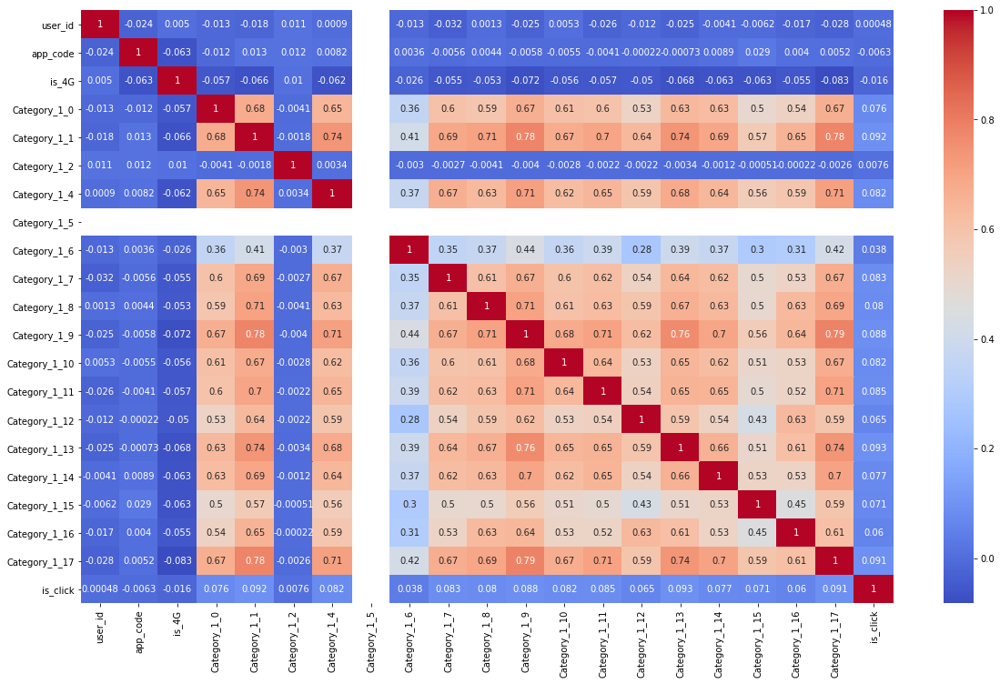

In [249]:
plt.figure(figsize=(20,12))
sns.heatmap(underSampledDataSet.corr(), cmap = 'coolwarm', annot=True)
plt.show()

In [261]:
underSampledDataSet[['Category_1_0', 'Category_1_2', 'app_code', 'is_4G']].head()

,Category_1_0,Category_1_2,app_code,is_4G
204636,4.0,0.0,5,0
43879,8.0,0.0,190,0
32242,0.0,0.0,473,0
27139,8.0,0.0,207,0
230348,2.0,0.0,44,1


In [262]:
lr2 = LogisticRegressionCV()
lr2.fit(underSampledDataSet[['Category_1_0', 'Category_1_2', 'app_code', 'is_4G']], underSampledDataSet['is_click'])

C:\Users\sarthak.agarwal\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


LogisticRegressionCV(Cs=10, class_weight=None, cv='warn', dual=False,
                     fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                     max_iter=100, multi_class='warn', n_jobs=None,
                     penalty='l2', random_state=None, refit=True, scoring=None,
                     solver='lbfgs', tol=0.0001, verbose=0)

In [264]:
lr2.score(X_test[['Category_1_0', 'Category_1_2', 'app_code', 'is_4G']], Y_test)

0.7207819536214806

In [267]:
roc_auc_score(Y_test, lr2.predict_proba(X_test[['Category_1_0', 'Category_1_2', 'app_code', 'is_4G']])[:,1])

0.555069258090309

### Check with SMOTE oversampling

In [152]:
sm = SMOTE(sampling_strategy='minority', random_state=42)

In [153]:
X_res, Y_res = sm.fit_resample(X_train, Y_train)

NameError: name 'X_train' is not defined

In [274]:
print(X_res.shape)
print(Y_res.shape)
print(X_train.shape)
print(Y_train.shape)

(362840, 20)
(362840,)
(190084, 20)
(190084,)


In [275]:
lr3 = LogisticRegressionCV()
lr3.fit(X_res, Y_res)

C:\Users\sarthak.agarwal\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


LogisticRegressionCV(Cs=10, class_weight=None, cv='warn', dual=False,
                     fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                     max_iter=100, multi_class='warn', n_jobs=None,
                     penalty='l2', random_state=None, refit=True, scoring=None,
                     solver='lbfgs', tol=0.0001, verbose=0)

In [278]:
filename = 'SmoteModel.sav'
pickle.dump(lr3, open(filename, 'wb'))

In [280]:
lr3Load = pickle.load(open(filename,'rb'))

In [281]:
lr3.score(X_test[['Category_1_0', 'Category_1_2', 'app_code', 'is_4G']], Y_test)

ValueError: X has 4 features per sample; expecting 20

In [285]:
lr3Load.score(X_test, Y_test)

0.6558225663903035

In [284]:
roc_auc_score(Y_test, lr3.predict_proba(X_test)[:,1])

0.5650755366135837

In [ ]:
# from sklearn.svm import SVC
# svm_clf = SVC()
# svm_clf.fit(X_res, Y_res)

C:\Users\sarthak.agarwal\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


In [1]:
time.time()

NameError: name 'time' is not defined

### Creating an is_active flag for a observation in train, if user is active in last 7 days in viewLog

In [286]:
trainData.head()

,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click
0,c4ca4238a0b923820dcc509a6f75849b,2018-11-15 00:00:00,87862,422,old,0,0
1,45c48cce2e2d7fbdea1afc51c7c6ad26,2018-11-15 00:01:00,63410,467,latest,1,1
2,70efdf2ec9b086079795c442636b55fb,2018-11-15 00:02:00,71748,259,intermediate,1,0
3,8e296a067a37563370ded05f5a3bf3ec,2018-11-15 00:02:00,69209,244,latest,1,0
4,182be0c5cdcd5072bb1864cdee4d3d6e,2018-11-15 00:02:00,62873,473,latest,0,0


In [306]:

a = datetime.datetime.strptime(trainData.iloc[0,1], "%Y-%m-%d %H:%M:%S")

In [315]:
str(a)

'2018-11-15 00:00:00'

In [308]:
a - datetime.timedelta(days = 16)

datetime.datetime(2018, 10, 30, 0, 0)

In [310]:
viewLogItemSorted = viewLogItem.sort_values?

In [6]:
viewLogItemSorted = viewLogItem.sort_values('server_time')
viewLogItemSorted.reset_index(drop=True).head()

,server_time,device_type,session_id,user_id,item_id,item_price,category_1,category_2,category_3,product_type
0,2018-10-15 08:58:00,android,112333,4557,32970,54685,16,56,253,3184
1,2018-10-15 08:58:00,android,121691,2430,12774,904,17,39,252,2740
2,2018-10-15 08:58:00,android,218564,19227,28296,2304,12,57,54,7422
3,2018-10-15 08:58:00,android,635314,87387,86660,10304,1,7,300,10149
4,2018-10-15 08:58:00,android,482459,348,35370,480,0,6,50,1457


In [364]:
viewLogItemSorted[(viewLogItemSorted['server_time'] < str(a)) & 
                  (str(a - datetime.timedelta(days = 7)) < viewLogItemSorted['server_time'])
                  & (viewLogItemSorted['user_id'] == 69209)].head(20)
# str(a - datetime.timedelta(days = 16)) <
# & (viewLogItemSorted['user_id'] == 4557)

,server_time,device_type,session_id,user_id,item_id,item_price,category_1,category_2,category_3,product_type
1145518,2018-11-11 21:18:00,android,943856,69209,53195,3008,11,51,220,8557
1591566,2018-11-12 23:43:00,android,192232,69209,45537,10752,9,44,114,9427
1145542,2018-11-12 23:45:00,android,192232,69209,53195,3008,11,51,220,8557
441671,2018-11-14 18:44:00,android,358781,69209,2121,249,0,45,117,6379
441672,2018-11-14 18:48:00,android,358781,69209,2121,249,0,45,117,6379
24859,2018-11-14 18:56:00,android,358781,69209,2715,1601,14,61,159,7093
24860,2018-11-14 18:58:00,android,358781,69209,2715,1601,14,61,159,7093
592063,2018-11-14 18:59:00,android,358781,69209,1528,7320,9,44,114,3528
24863,2018-11-14 19:01:00,android,358781,69209,2715,1601,14,61,159,7093
517853,2018-11-14 19:01:00,android,358781,69209,104035,819,8,21,139,2944


In [334]:
trainData.insert?

In [335]:
trainData.insert(trainData.shape[1], "is_active", [0] * trainData.shape[0], True)


In [378]:
trainData.head()

,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click,is_active
0,c4ca4238a0b923820dcc509a6f75849b,2018-11-15 00:00:00,87862,422,old,0,0,9
1,45c48cce2e2d7fbdea1afc51c7c6ad26,2018-11-15 00:01:00,63410,467,latest,1,1,9
2,70efdf2ec9b086079795c442636b55fb,2018-11-15 00:02:00,71748,259,intermediate,1,0,9
3,8e296a067a37563370ded05f5a3bf3ec,2018-11-15 00:02:00,69209,244,latest,1,0,8
4,182be0c5cdcd5072bb1864cdee4d3d6e,2018-11-15 00:02:00,62873,473,latest,0,0,2


In [345]:
trainData[['impression_time', 'user_id','impression_id']].head()

,impression_time,user_id,impression_id
0,2018-11-15 00:00:00,87862,c4ca4238a0b923820dcc509a6f75849b
1,2018-11-15 00:01:00,63410,45c48cce2e2d7fbdea1afc51c7c6ad26
2,2018-11-15 00:02:00,71748,70efdf2ec9b086079795c442636b55fb
3,2018-11-15 00:02:00,69209,8e296a067a37563370ded05f5a3bf3ec
4,2018-11-15 00:02:00,62873,182be0c5cdcd5072bb1864cdee4d3d6e


In [356]:
trainData.shape

(237609, 8)

In [354]:
trainData.loc[0,'is_active'] = 0

In [379]:
trainData['impression_date'] = trainData['impression_time'].apply(lambda x: x.split(" ")[0])

In [380]:
print(trainData.shape)
trainData.head()

(237609, 9)


,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click,is_active,impression_date
0,c4ca4238a0b923820dcc509a6f75849b,2018-11-15 00:00:00,87862,422,old,0,0,9,2018-11-15
1,45c48cce2e2d7fbdea1afc51c7c6ad26,2018-11-15 00:01:00,63410,467,latest,1,1,9,2018-11-15
2,70efdf2ec9b086079795c442636b55fb,2018-11-15 00:02:00,71748,259,intermediate,1,0,9,2018-11-15
3,8e296a067a37563370ded05f5a3bf3ec,2018-11-15 00:02:00,69209,244,latest,1,0,8,2018-11-15
4,182be0c5cdcd5072bb1864cdee4d3d6e,2018-11-15 00:02:00,62873,473,latest,0,0,2,2018-11-15


In [381]:
trainData.groupby?

In [382]:
trainDataGroupBy = trainData.groupby(['user_id', 'impression_date'])

In [389]:
trainDataGroupBy.loc[0,'is_active'] = 1

AttributeError: Cannot access callable attribute 'loc' of 'DataFrameGroupBy' objects, try using the 'apply' method

In [388]:
trainDataGroupBy.head()

,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click,is_active,impression_date
0,c4ca4238a0b923820dcc509a6f75849b,2018-11-15 00:00:00,87862,422,old,0,0,9,2018-11-15
1,45c48cce2e2d7fbdea1afc51c7c6ad26,2018-11-15 00:01:00,63410,467,latest,1,1,9,2018-11-15
2,70efdf2ec9b086079795c442636b55fb,2018-11-15 00:02:00,71748,259,intermediate,1,0,9,2018-11-15
3,8e296a067a37563370ded05f5a3bf3ec,2018-11-15 00:02:00,69209,244,latest,1,0,8,2018-11-15
4,182be0c5cdcd5072bb1864cdee4d3d6e,2018-11-15 00:02:00,62873,473,latest,0,0,2,2018-11-15
5,3416a75f4cea9109507cacd8e2f2aefc,2018-11-15 00:03:00,67352,409,latest,1,0,3,2018-11-15
6,f457c545a9ded88f18ecee47145a72c0,2018-11-15 00:03:00,64356,190,intermediate,0,0,0,2018-11-15
7,72b32a1f754ba1c09b3695e0cb6cde7f,2018-11-15 00:04:00,27329,481,latest,0,0,1,2018-11-15
8,fc490ca45c00b1249bbe3554a4fdf6fb,2018-11-15 00:05:00,83318,386,old,0,0,1,2018-11-15
9,d2ddea18f00665ce8623e36bd4e3c7c5,2018-11-15 00:05:00,70206,190,latest,0,0,0,2018-11-15


In [387]:
for index, row in trainDataGroupBy.head().iterrows():
    print(index,row)

0 impression_id      c4ca4238a0b923820dcc509a6f75849b
impression_time                 2018-11-15 00:00:00
user_id                                       87862
app_code                                        422
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         9
impression_date                          2018-11-15
Name: 0, dtype: object
1 impression_id      45c48cce2e2d7fbdea1afc51c7c6ad26
impression_time                 2018-11-15 00:01:00
user_id                                       63410
app_code                                        467
os_version                                   latest
is_4G                                             1
is_click                                          1
is_active                                         9
impression_date                          2018-11-15
Name: 1, dtype: object
2 impression_i

133 impression_id      feab05aa91085b7a8012516bc3533958
impression_time                 2018-11-15 03:55:00
user_id                                       43429
app_code                                        407
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                        13
impression_date                          2018-11-15
Name: 133, dtype: object
134 impression_id      55b1927fdafef39c48e5b73b5d61ea60
impression_time                 2018-11-15 04:00:00
user_id                                       43429
app_code                                        407
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                        13
impression_date                          2018-11-15
Name: 134, dtype: object
135 im

Name: 309, dtype: object
310 impression_id      f1981e4bd8a0d6d8462016d2fc6276b3
impression_time                 2018-11-15 07:19:00
user_id                                       51238
app_code                                         44
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         2
impression_date                          2018-11-15
Name: 310, dtype: object
311 impression_id      8d8818c8e140c64c743113f563cf750f
impression_time                 2018-11-15 07:19:00
user_id                                        2131
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         2
impression_date                          2018-11-15
Name: 

Name: 471, dtype: object
472 impression_id      d56b9fc4b0f1be8871f5e1c40c0067e7
impression_time                 2018-11-15 02:01:00
user_id                                        8809
app_code                                        244
os_version                             intermediate
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-15
Name: 472, dtype: object
473 impression_id      892c91e0a653ba19df81a90f89d99bcd
impression_time                 2018-11-15 02:03:00
user_id                                       91882
app_code                                        369
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 

Name: 646, dtype: object
647 impression_id      e8d66338fab3727e34a9179ed8804f64
impression_time                 2018-11-15 10:06:00
user_id                                       61091
app_code                                        249
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 647, dtype: object
648 impression_id      4fc848051e4459b8a6afeb210c3664ec
impression_time                 2018-11-15 10:07:00
user_id                                       10929
app_code                                        359
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 

810 impression_id      4ffce04d92a4d6cb21c1494cdfcd6dc1
impression_time                 2018-11-15 01:04:00
user_id                                       16607
app_code                                        385
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 810, dtype: object
811 impression_id      443cb001c138b2561a0d90720d6ce111
impression_time                 2018-11-15 01:06:00
user_id                                       11757
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 811, dtype: object
812 im

Name: 931, dtype: object
932 impression_id      5f6371c9126149517d9ba475def53139
impression_time                 2018-11-15 07:44:00
user_id                                       66716
app_code                                        207
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 932, dtype: object
933 impression_id      2b45c629e577731c4df84fc34f936a89
impression_time                 2018-11-15 07:45:00
user_id                                       11651
app_code                                        240
os_version                                   latest
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-15
Name: 

1117 impression_id      6aed000af86a084f9cb0264161e29dd3
impression_time                 2018-11-15 08:15:00
user_id                                       41205
app_code                                        129
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 1117, dtype: object
1118 impression_id      cc70903297fe1e25537ae50aea186306
impression_time                 2018-11-15 08:16:00
user_id                                       54781
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 1118, dtype: object
11

1310 impression_id      51425b752a0b402ed3effc83fc4bbb74
impression_time                 2018-11-15 14:06:00
user_id                                       17212
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 1310, dtype: object
1311 impression_id      fe256faf97c200de0f7486ddf56c02f6
impression_time                 2018-11-15 14:08:00
user_id                                       89052
app_code                                        250
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 1311, dtype: object
13

Name: 1559, dtype: object
1560 impression_id      32b991e5d77ad140559ffb95522992d0
impression_time                 2018-11-15 08:13:00
user_id                                        4745
app_code                                        190
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 1560, dtype: object
1561 impression_id      d756d3d2b9dac72449a6a6926534558a
impression_time                 2018-11-15 08:14:00
user_id                                       85566
app_code                                        135
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 1739, dtype: object
1740 impression_id      e615c82aba461681ade82da2da38004a
impression_time                 2018-11-15 16:26:00
user_id                                        2664
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 1740, dtype: object
1741 impression_id      6600e06fe9350b62c1e343504d4a7b86
impression_time                 2018-11-15 16:27:00
user_id                                       21300
app_code                                        385
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 1874, dtype: object
1875 impression_id      14e422f05b68cc0139988e128ee880df
impression_time                 2018-11-15 09:23:00
user_id                                         553
app_code                                         44
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 1875, dtype: object
1876 impression_id      2517756c5a9be6ac007fe9bb7fb92611
impression_time                 2018-11-15 09:24:00
user_id                                       64289
app_code                                        386
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 2032, dtype: object
2033 impression_id      adf7e293599134777339fdc40ddfa818
impression_time                 2018-11-15 17:52:00
user_id                                       36775
app_code                                        244
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 2033, dtype: object
2034 impression_id      817c99c4861918e518dca75d712983eb
impression_time                 2018-11-15 17:53:00
user_id                                       59980
app_code                                          3
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 2263, dtype: object
2264 impression_id      8da57fac3313174128cc5f13328d4573
impression_time                 2018-11-15 12:25:00
user_id                                       33314
app_code                                          3
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 2264, dtype: object
2265 impression_id      00003e3b9e5336685200ae85d21b4f5e
impression_time                 2018-11-15 12:26:00
user_id                                       38051
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 2433, dtype: object
2434 impression_id      926c11cc055de9b8d697b6a587d40c4d
impression_time                 2018-11-15 14:13:00
user_id                                        5250
app_code                                        190
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 2434, dtype: object
2435 impression_id      d9909824688daaad46d441eefd81eb38
impression_time                 2018-11-15 14:15:00
user_id                                       25934
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 2557, dtype: object
2558 impression_id      148148d62be67e0916a833931bd32b26
impression_time                 2018-11-15 14:31:00
user_id                                       60889
app_code                                        190
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 2558, dtype: object
2559 impression_id      941c377c73c0efed759c993f1b859526
impression_time                 2018-11-15 14:33:00
user_id                                       67997
app_code                                        210
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 2710, dtype: object
2711 impression_id      154f596a0e4aec4cf23ee4b76ae3d34a
impression_time                 2018-11-15 15:32:00
user_id                                        1195
app_code                                        256
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 2711, dtype: object
2712 impression_id      bcb7c13ff9746a60fa8c3e748acd054d
impression_time                 2018-11-15 15:33:00
user_id                                       10739
app_code                                        438
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 2884, dtype: object
2885 impression_id      8ab70731b1553f17c11a3bbc87e0b605
impression_time                 2018-11-15 16:58:00
user_id                                       47306
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 2885, dtype: object
2886 impression_id      9d38e6eab92b2aeb0a83b570188d5a1a
impression_time                 2018-11-15 16:59:00
user_id                                       42928
app_code                                        465
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 3082, dtype: object
3083 impression_id      3d191ef6e236bd1b9bdb9ff4743c47fe
impression_time                 2018-11-15 14:36:00
user_id                                       72963
app_code                                        207
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 3083, dtype: object
3084 impression_id      c17028c9b6e0c5deaad29665d582284a
impression_time                 2018-11-15 14:37:00
user_id                                       38257
app_code                                        385
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

3281 impression_id      5a5eab21ca2a8fef4af5e35709ecca15
impression_time                 2018-11-15 10:04:00
user_id                                       32295
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 3281, dtype: object
3282 impression_id      70162fe655ec381ac6312ebf026aac54
impression_time                 2018-11-15 10:05:00
user_id                                       91779
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 3282, dtype: object
32

Name: 3498, dtype: object
3499 impression_id      b2b7c555125ecacf4bb7678d9dc39a21
impression_time                 2018-11-15 10:26:00
user_id                                       46285
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 3499, dtype: object
3500 impression_id      1e8ca836c962598551882e689265c1c5
impression_time                 2018-11-15 10:26:00
user_id                                       32008
app_code                                        129
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 3662, dtype: object
3663 impression_id      ccc58dde99ac1c9f32531179b859bf46
impression_time                 2018-11-15 23:09:00
user_id                                       34434
app_code                                        244
os_version                                      old
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-15
Name: 3663, dtype: object
3664 impression_id      36a773b0b5996caee2eabbb5caa78023
impression_time                 2018-11-15 23:10:00
user_id                                       24066
app_code                                        371
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 3877, dtype: object
3878 impression_id      42778ef0b5805a96f9511e20b5611fce
impression_time                 2018-11-15 11:26:00
user_id                                       35719
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 3878, dtype: object
3879 impression_id      91299a41773c667d2ee8cddc3f6eeb64
impression_time                 2018-11-15 11:27:00
user_id                                        8377
app_code                                        318
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 4120, dtype: object
4121 impression_id      0dc23b6a0e4abc39904388dd3ffadcd1
impression_time                 2018-11-16 09:43:00
user_id                                       28227
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 4121, dtype: object
4122 impression_id      69748bbbc13bc56f17638e9f57b7a155
impression_time                 2018-11-16 09:46:00
user_id                                        2230
app_code                                        465
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

4247 impression_id      25d0a45ccd9e33b6b1ef8760801b6841
impression_time                 2018-11-16 11:19:00
user_id                                       16678
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 4247, dtype: object
4248 impression_id      ee6db9134a1add4f17b85c426b019a0d
impression_time                 2018-11-16 11:21:00
user_id                                       41500
app_code                                         44
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 4248, dtype: object
42

Name: 4429, dtype: object
4430 impression_id      420c841038c492fed4d19999a813009d
impression_time                 2018-11-16 14:36:00
user_id                                       45521
app_code                                        469
os_version                                   latest
is_4G                                             1
is_click                                          1
is_active                                         0
impression_date                          2018-11-16
Name: 4430, dtype: object
4431 impression_id      8e0251b8f27dd86e04c9049a1eeda4a3
impression_time                 2018-11-16 14:38:00
user_id                                       66829
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

Name: 4586, dtype: object
4587 impression_id      f490c742cd8318b8ee6dca10af2a163f
impression_time                 2018-11-15 21:37:00
user_id                                       36331
app_code                                         32
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 4587, dtype: object
4588 impression_id      2e0d41e02c5be4668ec1b0730b3346a8
impression_time                 2018-11-15 21:37:00
user_id                                       42809
app_code                                        244
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 4766, dtype: object
4767 impression_id      1f30c0ce8636ff2c424549971dcab5d8
impression_time                 2018-11-16 18:28:00
user_id                                       57732
app_code                                        359
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 4767, dtype: object
4768 impression_id      7f041c0dc0bc74c00d04f562504d778a
impression_time                 2018-11-16 18:29:00
user_id                                       14098
app_code                                        371
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

Name: 4936, dtype: object
4937 impression_id      f8b64946ebc86a5e23e1605a2943210c
impression_time                 2018-11-16 19:32:00
user_id                                       71247
app_code                                        261
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 4937, dtype: object
4938 impression_id      9f9e0c06d86af4c03ce5ec9fc618db10
impression_time                 2018-11-16 19:33:00
user_id                                       22034
app_code                                        469
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

5081 impression_id      ad0efad9dd0abaec4b8f9aaa489ec2f1
impression_time                 2018-11-16 02:09:00
user_id                                       89227
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 5081, dtype: object
5082 impression_id      273928cb4859a0db86ba8aefd34c1755
impression_time                 2018-11-16 20:49:00
user_id                                       65990
app_code                                        127
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 5082, dtype: object
50

5210 impression_id      ca49dcab7677fd5d3108f9a9b250d604
impression_time                 2018-11-16 09:12:00
user_id                                       50353
app_code                                        207
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 5210, dtype: object
5211 impression_id      67a3c1520c0b54c1f3be3fcfb4f1dca0
impression_time                 2018-11-16 09:15:00
user_id                                       59934
app_code                                        169
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 5211, dtype: object
52

Name: 5343, dtype: object
5344 impression_id      ab9a3f4c92c0f50204a1fe6dbf2e1d0a
impression_time                 2018-11-16 12:41:00
user_id                                       76618
app_code                                        242
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 5344, dtype: object
5345 impression_id      25d36360c95ddcdd9687dd95f09ab64c
impression_time                 2018-11-16 22:57:00
user_id                                       18246
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

Name: 5502, dtype: object
5503 impression_id      dc4781e4d7949791a2c973340de4a010
impression_time                 2018-11-16 23:56:00
user_id                                       54663
app_code                                         38
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 5503, dtype: object
5504 impression_id      1577e5ef0c7cf5fea7ec297c0d4adc36
impression_time                 2018-11-16 23:57:00
user_id                                       53920
app_code                                         38
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

Name: 5711, dtype: object
5712 impression_id      d6539d3b57159babf6a72e106beb45bd
impression_time                 2018-11-15 17:30:00
user_id                                       90385
app_code                                        207
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 5712, dtype: object
5713 impression_id      9bcb182ab31f229322cff3c8888b2cec
impression_time                 2018-11-15 17:31:00
user_id                                       19080
app_code                                        190
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 5949, dtype: object
5950 impression_id      6d0893ce02e4926539d6f7e0601c6161
impression_time                 2018-11-16 17:47:00
user_id                                       65399
app_code                                        386
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 5950, dtype: object
5951 impression_id      2e09811007f834b96935dc13e91fabbc
impression_time                 2018-11-16 17:47:00
user_id                                       72005
app_code                                        242
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

Name: 6172, dtype: object
6173 impression_id      7558a03211f17086e4b8d0fbd35e9a6a
impression_time                 2018-11-17 13:29:00
user_id                                       50509
app_code                                        448
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 6173, dtype: object
6174 impression_id      07662abf6d1635f05215d0614a1b6329
impression_time                 2018-11-17 13:31:00
user_id                                       30923
app_code                                          5
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Na

Name: 6314, dtype: object
6315 impression_id      342c472b95d00421be10e9512b532866
impression_time                 2018-11-15 20:10:00
user_id                                        5849
app_code                                        469
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 6315, dtype: object
6316 impression_id      47f91db40efc6a22350eca5c953c4742
impression_time                 2018-11-15 20:10:00
user_id                                        3928
app_code                                          3
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

Name: 6496, dtype: object
6497 impression_id      a576eafbce762079f7d1f77fca1c5cc2
impression_time                 2018-11-16 00:41:00
user_id                                       68970
app_code                                         32
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 6497, dtype: object
6498 impression_id      d530d454337fb09964237fecb4bea6ce
impression_time                 2018-11-16 00:42:00
user_id                                       53757
app_code                                        242
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

Name: 6778, dtype: object
6779 impression_id      4a5b76e7170df685ed8b75c7dacce268
impression_time                 2018-11-16 21:35:00
user_id                                       48257
app_code                                        386
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 6779, dtype: object
6780 impression_id      1d0155b49e8121154701476d893aa0a7
impression_time                 2018-11-16 21:36:00
user_id                                       38368
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

7018 impression_id      519edc8db508d1c088f793f2c3647e6f
impression_time                 2018-11-17 16:52:00
user_id                                       36607
app_code                                          3
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 7018, dtype: object
7019 impression_id      5af2de2fbcd7535745699d05f0481ca4
impression_time                 2018-11-17 16:54:00
user_id                                       56716
app_code                                        127
os_version                                   latest
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-17
Name: 7019, dtype: object
70

Name: 7148, dtype: object
7149 impression_id      2c5201a7391fedbc40c3cc6aa057a029
impression_time                 2018-11-16 12:02:00
user_id                                       28553
app_code                                        371
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 7149, dtype: object
7150 impression_id      a529ea43c249fcbee9685c74d8baa9eb
impression_time                 2018-11-16 12:04:00
user_id                                       11395
app_code                                        296
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Na

Name: 7400, dtype: object
7401 impression_id      b87039703fe79778e9f140b78621d7fb
impression_time                 2018-11-15 21:07:00
user_id                                       60255
app_code                                          3
os_version                             intermediate
is_4G                                             1
is_click                                          1
is_active                                         0
impression_date                          2018-11-15
Name: 7401, dtype: object
7402 impression_id      5c341d10c5596a0fd920fda9f33bcb06
impression_time                 2018-11-15 21:08:00
user_id                                       44973
app_code                                        127
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Na

7599 impression_id      68e0937d0f20f63d46f066cb42c048a0
impression_time                 2018-11-16 17:18:00
user_id                                       39611
app_code                                        386
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 7599, dtype: object
7600 impression_id      ca6037b5974c5b0dac440bcdfb299bce
impression_time                 2018-11-16 17:19:00
user_id                                       57897
app_code                                        318
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 7600, dtype: object
76

7777 impression_id      78df662f141715d49dad1c3a3b356531
impression_time                 2018-11-17 10:03:00
user_id                                       34330
app_code                                        503
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 7777, dtype: object
7778 impression_id      366971226c73b87ab69e87918b9338a5
impression_time                 2018-11-17 19:07:00
user_id                                       85997
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 7778, dtype: object
77

Name: 8013, dtype: object
8014 impression_id      016b493fcc43c162e3e40250430630c8
impression_time                 2018-11-17 14:18:00
user_id                                       23119
app_code                                        385
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 8014, dtype: object
8015 impression_id      dcacc2b04bdf831ef070af1abeb61d7a
impression_time                 2018-11-17 14:19:00
user_id                                       61334
app_code                                        207
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Na

8192 impression_id      20a85fedde1a26e56fe6b07f9e6192f0
impression_time                 2018-11-17 17:36:00
user_id                                       36735
app_code                                         16
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 8192, dtype: object
8193 impression_id      3391f7714552ccfd36c887e27dee4842
impression_time                 2018-11-17 20:26:00
user_id                                       24381
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 8193, dtype: object
81

Name: 8376, dtype: object
8377 impression_id      a9a6bc8f86138d7b4c7a186ceb947b62
impression_time                 2018-11-17 22:16:00
user_id                                       20746
app_code                                        190
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 8377, dtype: object
8378 impression_id      ebfa1b41f4b42d1c0b703182ef4aaf1d
impression_time                 2018-11-17 22:17:00
user_id                                       40853
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Na

Name: 8619, dtype: object
8620 impression_id      86db3b646f1bf959eb7fbefcf4ed02d2
impression_time                 2018-11-17 21:21:00
user_id                                       52098
app_code                                        175
os_version                             intermediate
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-17
Name: 8620, dtype: object
8621 impression_id      bb63947c75d49061c743a2ae53cc1787
impression_time                 2018-11-17 21:23:00
user_id                                       11128
app_code                                          5
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Na

8864 impression_id      6f1c6c3c7bb52eb41a2cbd0f28b308a7
impression_time                 2018-11-18 09:14:00
user_id                                       67555
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 8864, dtype: object
8865 impression_id      196ef39dc3c14c0b8aa88d99f31e8710
impression_time                 2018-11-18 09:25:00
user_id                                       26758
app_code                                        409
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 8865, dtype: object
88

Name: 9093, dtype: object
9094 impression_id      9c300b9f50804a3f7d559bf20f64a1c8
impression_time                 2018-11-18 15:57:00
user_id                                       27839
app_code                                        375
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 9094, dtype: object
9095 impression_id      b62fc92a2561538525c89be63f36bf7b
impression_time                 2018-11-18 15:59:00
user_id                                       78086
app_code                                        127
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Na

Name: 9279, dtype: object
9280 impression_id      10155a0cc6dde7d912d2ac796956876d
impression_time                 2018-11-18 20:07:00
user_id                                       75823
app_code                                        463
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 9280, dtype: object
9281 impression_id      8f1ac1569697283fb7739acf854fef05
impression_time                 2018-11-18 20:08:00
user_id                                       65931
app_code                                        386
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Na

9427 impression_id      72e754f660f88907d334e4436de03081
impression_time                 2018-11-18 01:30:00
user_id                                       30278
app_code                                        244
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 9427, dtype: object
9428 impression_id      6f2fed8e626e7d1238e8d15a3104a42b
impression_time                 2018-11-18 01:32:00
user_id                                       52744
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 9428, dtype: object
94

Name: 9646, dtype: object
9647 impression_id      3ae84dcbd2cfadb3fdd4d58dbaa386ef
impression_time                 2018-11-18 13:39:00
user_id                                       11499
app_code                                        151
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 9647, dtype: object
9648 impression_id      96045cb4b220959781bbbff6f5367268
impression_time                 2018-11-18 13:42:00
user_id                                       88239
app_code                                        244
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Na

9798 impression_id      74a9013d7b74ca4a87c9f6ae51956d66
impression_time                 2018-11-18 15:38:00
user_id                                       75355
app_code                                          7
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 9798, dtype: object
9799 impression_id      6edf4b8ea5fb8603fcf25f2438205094
impression_time                 2018-11-18 15:39:00
user_id                                       79702
app_code                                        127
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 9799, dtype: object
98

Name: 10045, dtype: object
10046 impression_id      151eece7fb451c947b351ae861e8cd9f
impression_time                 2018-11-18 19:32:00
user_id                                       44178
app_code                                        244
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 10046, dtype: object
10047 impression_id      84f3ad98554f4c77f309c271fb93e1e7
impression_time                 2018-11-18 19:34:00
user_id                                       61086
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

10186 impression_id      6964e9d5cd1aab8c7c72b12b77f2fd20
impression_time                 2018-11-18 22:11:00
user_id                                       23610
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 10186, dtype: object
10187 impression_id      80154d0cf42299d38de5046efc2429a3
impression_time                 2018-11-18 22:13:00
user_id                                       64559
app_code                                        163
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 10187, dtype: objec

10361 impression_id      5557b67c89b4ff20c165303cfa98a81a
impression_time                 2018-11-19 04:28:00
user_id                                        4529
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 10361, dtype: object
10362 impression_id      b85b19cea2f0268e105f30d78f668250
impression_time                 2018-11-19 04:45:00
user_id                                       73231
app_code                                        371
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 10362, dtype: objec

10591 impression_id      a70f6138de778744f7b767b618b5d52d
impression_time                 2018-11-19 01:33:00
user_id                                       70909
app_code                                        129
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 10591, dtype: object
10592 impression_id      f1b824c353b9b2bb1327e0e72a05b6b9
impression_time                 2018-11-19 01:35:00
user_id                                         708
app_code                                        129
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 10592, dtype: objec

Name: 10849, dtype: object
10850 impression_id      df3d2375daa4391c1b3f8dfdc2fbca04
impression_time                 2018-11-16 21:42:00
user_id                                       38427
app_code                                        296
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 10850, dtype: object
10851 impression_id      e44956a0a9118d2bfe39f3483f57db37
impression_time                 2018-11-16 21:43:00
user_id                                        6816
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

11037 impression_id      3f826f30bc252fb41b7ef03b98ee98c8
impression_time                 2018-11-16 23:03:00
user_id                                       35126
app_code                                        127
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 11037, dtype: object
11038 impression_id      49d7d1860f0dc2bfcb95ea0fe787c98b
impression_time                 2018-11-16 23:04:00
user_id                                       58178
app_code                                        421
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 11038, dtype: objec

Name: 11217, dtype: object
11218 impression_id      cef21a66d373d6285f35519d5260c676
impression_time                 2018-11-17 00:53:00
user_id                                       72193
app_code                                        129
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 11218, dtype: object
11219 impression_id      62ab12646d5ee17a595a43b59f2523d1
impression_time                 2018-11-17 00:54:00
user_id                                       84856
app_code                                         23
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

11416 impression_id      5143cf8618ed4a4d16edfebaf7728139
impression_time                 2018-11-17 08:16:00
user_id                                       60662
app_code                                        359
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 11416, dtype: object
11417 impression_id      7b972beaf37e2de7dbe066961a5d5c1c
impression_time                 2018-11-17 08:23:00
user_id                                       72429
app_code                                        371
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 11417, dtype: objec

Name: 11658, dtype: object
11659 impression_id      85ebad98d8a178be8baf16929526446e
impression_time                 2018-11-16 19:08:00
user_id                                       20072
app_code                                        469
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 11659, dtype: object
11660 impression_id      d45b6d92e35ff59d3f5a1861e431d581
impression_time                 2018-11-16 19:09:00
user_id                                       40680
app_code                                          3
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 11781, dtype: object
11782 impression_id      379d08c7a38df48c777c07ea990a3bcf
impression_time                 2018-11-16 20:47:00
user_id                                        4867
app_code                                        127
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 11782, dtype: object
11783 impression_id      349f259c872c43d1ea241ba414c5b70b
impression_time                 2018-11-16 20:49:00
user_id                                         454
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 12018, dtype: object
12019 impression_id      484e01517b1395d6f8cce27fcc459cbf
impression_time                 2018-11-16 23:56:00
user_id                                       91340
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 12019, dtype: object
12020 impression_id      a5460fe6c23289fddcfe66efe033ae08
impression_time                 2018-11-16 23:58:00
user_id                                       83978
app_code                                        275
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

12142 impression_id      9fb640ea6abe0e849c8c1fd6eea97c22
impression_time                 2018-11-17 01:14:00
user_id                                       28615
app_code                                        296
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 12142, dtype: object
12143 impression_id      c0f48c8ab1b8e41d825d24714e851659
impression_time                 2018-11-17 01:15:00
user_id                                       76358
app_code                                        275
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 12143, dtype: objec

12303 impression_id      718010c95cc6dac83386e13c4635def8
impression_time                 2018-11-17 09:24:00
user_id                                       46357
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 12303, dtype: object
12304 impression_id      a2b58f07313388cd23868784a6759b64
impression_time                 2018-11-17 09:27:00
user_id                                       42876
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 12304, dtype: objec

12449 impression_id      d52a77a7e1cfe7d483b6539171b03e64
impression_time                 2018-11-17 13:24:00
user_id                                       12211
app_code                                        207
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 12449, dtype: object
12450 impression_id      86ad2abe9aa87efa03c4bbee3fb005b2
impression_time                 2018-11-17 13:26:00
user_id                                       64263
app_code                                        129
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 12450, dtype: objec

Name: 12627, dtype: object
12628 impression_id      bbc77a1cfac6902c0966cbf2959b9c02
impression_time                 2018-11-17 16:57:00
user_id                                       78317
app_code                                        386
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 12628, dtype: object
12629 impression_id      6145e68bda614971203985cec5982a6b
impression_time                 2018-11-17 16:59:00
user_id                                       30844
app_code                                        190
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 12844, dtype: object
12845 impression_id      10033cdf4e52735b87aa18c7948b2adc
impression_time                 2018-11-17 22:13:00
user_id                                       70718
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 12845, dtype: object
12846 impression_id      1e88294e34f2278bd1e0392f4493a3eb
impression_time                 2018-11-17 22:15:00
user_id                                        5539
app_code                                        372
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

13004 impression_id      23bdbd6765499c3d4922cb2821ec26d5
impression_time                 2018-11-17 23:47:00
user_id                                       18289
app_code                                        390
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 13004, dtype: object
13005 impression_id      a249084ad4bce339b204ab436db2d902
impression_time                 2018-11-17 23:48:00
user_id                                       68408
app_code                                        386
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 13005, dtype: objec

13157 impression_id      6953aa7895c6af344d03401184eaf8e4
impression_time                 2018-11-18 00:53:00
user_id                                       88873
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 13157, dtype: object
13158 impression_id      404e0793ba47ba6ec7b52aefe9ac9cfb
impression_time                 2018-11-18 00:55:00
user_id                                       86730
app_code                                        190
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 13158, dtype: objec

Name: 13337, dtype: object
13338 impression_id      a60c71bd110ebc4d6916e16b8ca24fda
impression_time                 2018-11-18 09:07:00
user_id                                       73127
app_code                                        120
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 13338, dtype: object
13339 impression_id      fe6dee4bb454be55d5d06531e9229aef
impression_time                 2018-11-18 09:14:00
user_id                                       34977
app_code                                        386
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

13573 impression_id      29a3101057addf321ba7e44920e4f23b
impression_time                 2018-11-18 16:01:00
user_id                                        6216
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 13573, dtype: object
13574 impression_id      2fd71648d0bfec3f35c7415c3901a72c
impression_time                 2018-11-18 16:01:00
user_id                                       18523
app_code                                        190
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 13574, dtype: objec

Name: 13733, dtype: object
13734 impression_id      e624d754286d0aac962f185f1a21809e
impression_time                 2018-11-18 19:41:00
user_id                                       76662
app_code                                          5
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 13734, dtype: object
13735 impression_id      488040033894d00123c7afa479a90bc5
impression_time                 2018-11-18 19:43:00
user_id                                       37390
app_code                                        129
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 13891, dtype: object
13892 impression_id      9216ab2940fd8b819d833bd0cdc5dadc
impression_time                 2018-11-18 01:13:00
user_id                                       65598
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 13892, dtype: object
13893 impression_id      d942d71d77b0fd96f086b86a806f9a02
impression_time                 2018-11-18 01:14:00
user_id                                       20912
app_code                                        368
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

14061 impression_id      fdb0dfc7a10173835252be882819b650
impression_time                 2018-11-18 12:50:00
user_id                                       71723
app_code                                        163
os_version                                   latest
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-18
Name: 14061, dtype: object
14062 impression_id      8451dd97e66989d4b6d30d118cb8270e
impression_time                 2018-11-18 12:51:00
user_id                                        2204
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 14062, dtype: objec

14261 impression_id      368c6ba2da64fec44a2a7efd49d74e01
impression_time                 2018-11-18 15:17:00
user_id                                       57056
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 14261, dtype: object
14262 impression_id      93fb03efcd98ca5aa136ff9f761c9c2d
impression_time                 2018-11-18 15:19:00
user_id                                        3179
app_code                                        386
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 14262, dtype: objec

Name: 14486, dtype: object
14487 impression_id      de670c6775d17d4f699e427ab9260fa3
impression_time                 2018-11-18 18:47:00
user_id                                        3362
app_code                                        163
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 14487, dtype: object
14488 impression_id      57b01adc7eb0a085a9eed546e5b0f617
impression_time                 2018-11-18 18:48:00
user_id                                       59579
app_code                                        440
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 14663, dtype: object
14664 impression_id      4b84a4fbb709d5887d092b74ee5d6724
impression_time                 2018-11-18 22:18:00
user_id                                       67006
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 14664, dtype: object
14665 impression_id      59a57dd9c157d6b95b56dfaebb6a45e3
impression_time                 2018-11-18 22:19:00
user_id                                       51732
app_code                                        386
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

14873 impression_id      56bc2ffafe5268122fb8c00807dea91f
impression_time                 2018-11-19 09:10:00
user_id                                       83475
app_code                                          3
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 14873, dtype: object
14874 impression_id      6fc838626a3f3a11ad0c84dd302d6a8a
impression_time                 2018-11-19 09:13:00
user_id                                       48151
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 14874, dtype: objec

Name: 15062, dtype: object
15063 impression_id      56c25287be94f28752503a1cb341c896
impression_time                 2018-11-19 01:31:00
user_id                                       21887
app_code                                         32
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 15063, dtype: object
15064 impression_id      8befb4efe8ce6cdf0e1a84974d452a9f
impression_time                 2018-11-19 01:32:00
user_id                                       65742
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

15312 impression_id      06b8b645831a17ca4a108b5be6f756ac
impression_time                 2018-11-19 10:54:00
user_id                                       16020
app_code                                        242
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 15312, dtype: object
15313 impression_id      c071c86446066d4de2ba1551614a08c8
impression_time                 2018-11-19 10:57:00
user_id                                       62460
app_code                                        207
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 15313, dtype: objec

Name: 15511, dtype: object
15512 impression_id      4371a529ba9a419a1dc903bcd8856251
impression_time                 2018-11-19 13:29:00
user_id                                       23052
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 15512, dtype: object
15513 impression_id      a7290c5bd7bc2aaa7ea2b6c957ef639b
impression_time                 2018-11-19 13:31:00
user_id                                       35298
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 15678, dtype: object
15679 impression_id      96629f1aac6ddb7a7cfa82574b6722d4
impression_time                 2018-11-15 09:00:00
user_id                                       13238
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 15679, dtype: object
15680 impression_id      9e6a921fbc428b5638b3986e365d4f21
impression_time                 2018-11-15 09:00:00
user_id                                       74262
app_code                                        351
os_version                                      old
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-1

Name: 15880, dtype: object
15881 impression_id      9eac167ec1efbe078138397fabba902e
impression_time                 2018-11-15 10:03:00
user_id                                       65098
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 15881, dtype: object
15882 impression_id      dc0439caeb74ffc2795571af07a7eab1
impression_time                 2018-11-15 10:04:00
user_id                                       27353
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

16034 impression_id      bf56a1b37b94243486b2034f8479c475
impression_time                 2018-11-15 11:08:00
user_id                                       41205
app_code                                        129
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 16034, dtype: object
16035 impression_id      8620005ac78d8257435d490058c643dd
impression_time                 2018-11-15 11:09:00
user_id                                       36086
app_code                                        261
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 16035, dtype: objec

16281 impression_id      7e230522657ecdc50e4249581b861f8e
impression_time                 2018-11-15 06:38:00
user_id                                       13968
app_code                                         32
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 16281, dtype: object
16282 impression_id      e4873aa9a05cc5ed839561d121516766
impression_time                 2018-11-15 06:39:00
user_id                                       11838
app_code                                        440
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 16282, dtype: objec

Name: 16516, dtype: object
16517 impression_id      18b91b19f6a289e7708da7f778b2c609
impression_time                 2018-11-15 15:01:00
user_id                                        1674
app_code                                        469
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 16517, dtype: object
16518 impression_id      024d2d699e6c1a82c9ba986386f4d824
impression_time                 2018-11-15 15:03:00
user_id                                       85117
app_code                                        127
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

16789 impression_id      46f712a2eada5a5870a2b5ff2bd2244e
impression_time                 2018-11-19 18:48:00
user_id                                       14775
app_code                                        371
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 16789, dtype: object
16790 impression_id      a2a52743471fc9d71744e35fa3625217
impression_time                 2018-11-19 18:49:00
user_id                                         604
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 16790, dtype: objec

16965 impression_id      cfefe028584e7a3f406e1096e7daaaff
impression_time                 2018-11-19 17:41:00
user_id                                       12140
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 16965, dtype: object
16966 impression_id      823e7bde3c29d63fc14b1178cfd8d997
impression_time                 2018-11-19 17:42:00
user_id                                        1045
app_code                                        296
os_version                                      old
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-19
Name: 16966, dtype: objec

Name: 17209, dtype: object
17210 impression_id      d26e5e36c1b0b620407eadabb6c0c5c2
impression_time                 2018-11-15 18:18:00
user_id                                       78218
app_code                                        469
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 17210, dtype: object
17211 impression_id      2b763288faedb7707c0748abe015ab6c
impression_time                 2018-11-15 18:19:00
user_id                                       35286
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

17349 impression_id      a62178a8e59f8331e1cb4f057cbf0a55
impression_time                 2018-11-15 18:44:00
user_id                                       62335
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 17349, dtype: object
17350 impression_id      44e76e99b5e194377e955b13fb12f630
impression_time                 2018-11-15 18:45:00
user_id                                       79193
app_code                                          5
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 17350, dtype: objec

Name: 17545, dtype: object
17546 impression_id      1cc8a8ea51cd0adddf5dab504a285915
impression_time                 2018-11-15 11:34:00
user_id                                       52290
app_code                                          5
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 17546, dtype: object
17547 impression_id      084afd913ab1e6ea58b8ca73f6cb41a6
impression_time                 2018-11-15 11:34:00
user_id                                        1999
app_code                                        289
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 17740, dtype: object
17741 impression_id      ca7ca7ea7912312362a50c3754c1cc2d
impression_time                 2018-11-20 01:21:00
user_id                                       26586
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 17741, dtype: object
17742 impression_id      75e4b350d35c7e5892cfd9432683c990
impression_time                 2018-11-20 01:24:00
user_id                                       28222
app_code                                        385
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 17899, dtype: object
17900 impression_id      d7bf523a314c5d650e9b49cd3788cc82
impression_time                 2018-11-20 09:10:00
user_id                                       46832
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 17900, dtype: object
17901 impression_id      9987439b9205fa1e757a7d32cc51777f
impression_time                 2018-11-20 09:12:00
user_id                                          69
app_code                                        207
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 18042, dtype: object
18043 impression_id      6f0ca67289d79eb35d19decbc0a08453
impression_time                 2018-11-15 21:58:00
user_id                                       63100
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 18043, dtype: object
18044 impression_id      dfc7defac6624a80f02b02e22b14e8fd
impression_time                 2018-11-15 21:59:00
user_id                                       90060
app_code                                        129
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 18239, dtype: object
18240 impression_id      547b85f3fafdf30856386753dc21c4e1
impression_time                 2018-11-15 18:20:00
user_id                                        9701
app_code                                          3
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 18240, dtype: object
18241 impression_id      1e9b64527e41c7360750af533155aebd
impression_time                 2018-11-15 18:20:00
user_id                                       57829
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 18421, dtype: object
18422 impression_id      abcc5329cfe5846db63ff4dee74eb906
impression_time                 2018-11-15 20:12:00
user_id                                       49230
app_code                                        318
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 18422, dtype: object
18423 impression_id      ef8b5fcc338e003145ac9c134754db71
impression_time                 2018-11-15 20:13:00
user_id                                       24965
app_code                                          3
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 18620, dtype: object
18621 impression_id      17737832ac17be5216f187a82c20936e
impression_time                 2018-11-16 00:03:00
user_id                                       28912
app_code                                        190
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 18621, dtype: object
18622 impression_id      33a854e247155d590883b93bca53848a
impression_time                 2018-11-16 00:04:00
user_id                                       59032
app_code                                          3
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

18784 impression_id      1be5b1b81fb31616482ac54524fe159b
impression_time                 2018-11-19 20:11:00
user_id                                       19131
app_code                                        135
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 18784, dtype: object
18785 impression_id      ffdd909cdb7fa6ea26c328488c4b8b76
impression_time                 2018-11-19 20:12:00
user_id                                       87733
app_code                                        144
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 18785, dtype: objec

18992 impression_id      a1d50185e7426cbb0acad1e6ca74b9aa
impression_time                 2018-11-15 03:57:00
user_id                                       71483
app_code                                        129
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 18992, dtype: object
18993 impression_id      285f89b802bcb2651801455c86d78f2a
impression_time                 2018-11-15 04:00:00
user_id                                       11823
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 18993, dtype: objec

Name: 19188, dtype: object
19189 impression_id      65903d6bc9979bfb4817643c0e12b11e
impression_time                 2018-11-19 12:07:00
user_id                                       74014
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 19189, dtype: object
19190 impression_id      5963591837f554529b3d9c4e209b74a0
impression_time                 2018-11-19 12:09:00
user_id                                        5138
app_code                                        190
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 19396, dtype: object
19397 impression_id      0415740eaa4d9decbc8da001d3fd805f
impression_time                 2018-11-15 08:23:00
user_id                                       83752
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 19397, dtype: object
19398 impression_id      65f2a94c8c2d56d5b43a1a3d9d811102
impression_time                 2018-11-15 08:24:00
user_id                                       26577
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 19567, dtype: object
19568 impression_id      cb953f6ca5923f7517125db46ed1293d
impression_time                 2018-11-15 09:32:00
user_id                                       19090
app_code                                        296
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 19568, dtype: object
19569 impression_id      6c91724b896cdcf48285039ab05b3aaf
impression_time                 2018-11-15 09:33:00
user_id                                       12209
app_code                                        473
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

19764 impression_id      cfee398643cbc3dc5eefc89334cacdc1
impression_time                 2018-11-15 00:44:00
user_id                                       64082
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 19764, dtype: object
19765 impression_id      7d04bbbe5494ae9d2f5a76aa1c00fa2f
impression_time                 2018-11-15 00:45:00
user_id                                       67170
app_code                                        127
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 19765, dtype: objec

Name: 20010, dtype: object
20011 impression_id      9b69699ed4a1d25a4f6e6c62fc0b26fe
impression_time                 2018-11-19 16:06:00
user_id                                       28268
app_code                                        150
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 20011, dtype: object
20012 impression_id      a152eaeb339ba64af0201c75de9e12c0
impression_time                 2018-11-19 16:07:00
user_id                                       30961
app_code                                        129
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

20135 impression_id      9fe97fff97f089661135d0487843108e
impression_time                 2018-11-15 06:47:00
user_id                                       47151
app_code                                         32
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 20135, dtype: object
20136 impression_id      8bb88f80d334b1869781beb89f7b73be
impression_time                 2018-11-15 06:48:00
user_id                                        2631
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 20136, dtype: objec

Name: 20307, dtype: object
20308 impression_id      f55cadb97eaff2ba1980e001b0bd9842
impression_time                 2018-11-15 08:02:00
user_id                                       16668
app_code                                        296
os_version                                   latest
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-15
Name: 20308, dtype: object
20309 impression_id      9af76329c78e28c977ab1bcd1c3fe9b8
impression_time                 2018-11-15 08:04:00
user_id                                       45293
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 20477, dtype: object
20478 impression_id      c1014dccbadfa3bd223e055e26e65527
impression_time                 2018-11-19 18:04:00
user_id                                       64632
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 20478, dtype: object
20479 impression_id      7b7114a49b5827132d6097582ec1722d
impression_time                 2018-11-19 18:05:00
user_id                                       44899
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

20650 impression_id      81e793dc8317a3dbc3534ed3f242c418
impression_time                 2018-11-15 16:26:00
user_id                                       65128
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 20650, dtype: object
20651 impression_id      400e5e6a7ce0c754f281525fae75a873
impression_time                 2018-11-15 16:27:00
user_id                                       40642
app_code                                        190
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 20651, dtype: objec

Name: 20836, dtype: object
20837 impression_id      e8542a04d734d0cae36d648b3f519e5c
impression_time                 2018-11-15 09:53:00
user_id                                       75339
app_code                                        242
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 20837, dtype: object
20838 impression_id      2e3d2c4f33a7a1f58bc6c81cacd21e9c
impression_time                 2018-11-15 09:54:00
user_id                                       61060
app_code                                          3
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 21023, dtype: object
21024 impression_id      42e9fb755426f19231217afb43e1aec1
impression_time                 2018-11-15 17:56:00
user_id                                       12605
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 21024, dtype: object
21025 impression_id      456048afb7253926e1fbb7486e699180
impression_time                 2018-11-15 17:57:00
user_id                                       84756
app_code                                        145
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 21216, dtype: object
21217 impression_id      9ee70b7987a735c046ac30a1556272c8
impression_time                 2018-11-15 10:52:00
user_id                                       29918
app_code                                        249
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 21217, dtype: object
21218 impression_id      50a074e6a8da4662ae0a29edde722179
impression_time                 2018-11-15 10:53:00
user_id                                       29473
app_code                                        250
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

21488 impression_id      bd9dc58c7af906cdbac364aedd4c0848
impression_time                 2018-11-15 20:01:00
user_id                                       48124
app_code                                        296
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 21488, dtype: object
21489 impression_id      e025b6279c1b88d3ec0eca6fcb6e6280
impression_time                 2018-11-15 20:02:00
user_id                                       52400
app_code                                        319
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 21489, dtype: objec

Name: 21675, dtype: object
21676 impression_id      9ceee7501ba30946fab8728aec06a9f5
impression_time                 2018-11-15 12:26:00
user_id                                       80946
app_code                                        296
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 21676, dtype: object
21677 impression_id      4f714c73db5191f3a71a380cba8843ed
impression_time                 2018-11-15 12:27:00
user_id                                       69007
app_code                                        207
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

21892 impression_id      1d936dadf30010a96155a780553d5513
impression_time                 2018-11-15 22:06:00
user_id                                       12712
app_code                                         32
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 21892, dtype: object
21893 impression_id      1147dc16a8e1b44eead07282cad093f8
impression_time                 2018-11-15 22:07:00
user_id                                        7815
app_code                                        190
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 21893, dtype: objec

Name: 22015, dtype: object
22016 impression_id      2ba2520186ee376e835ce7bf1554ef7b
impression_time                 2018-11-15 17:09:00
user_id                                       29857
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 22016, dtype: object
22017 impression_id      55ed523b2ca4371a31d7dbd7a2877bea
impression_time                 2018-11-15 17:11:00
user_id                                       42239
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 22330, dtype: object
22331 impression_id      f3c1261d2a929b173a2536fa606fa704
impression_time                 2018-11-20 12:52:00
user_id                                       26869
app_code                                        170
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 22331, dtype: object
22332 impression_id      68624a8a1f8dd04e260c0173bad7ee31
impression_time                 2018-11-20 12:53:00
user_id                                        5218
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

22452 impression_id      4910fcdaedc2be5c5f05533b7a9cb8c2
impression_time                 2018-11-15 23:56:00
user_id                                        9223
app_code                                        249
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 22452, dtype: object
22453 impression_id      96e76211d21b66fbdaf1a05498b4417a
impression_time                 2018-11-15 23:57:00
user_id                                       65371
app_code                                        414
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 22453, dtype: objec

Name: 22605, dtype: object
22606 impression_id      501e3f8a108d7ab9335ceecd363d113d
impression_time                 2018-11-16 00:54:00
user_id                                       88127
app_code                                        190
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 22606, dtype: object
22607 impression_id      231e535a63030cd69bf4b9a07d9968bf
impression_time                 2018-11-16 00:55:00
user_id                                       58503
app_code                                        386
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

22822 impression_id      e1c60d74120b7d2257c1f2a7561dfe41
impression_time                 2018-11-19 22:37:00
user_id                                       58693
app_code                                        242
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 22822, dtype: object
22823 impression_id      83e1c26494d0a57bd1f806b8b7f283b3
impression_time                 2018-11-19 22:38:00
user_id                                       15804
app_code                                        190
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 22823, dtype: objec

23019 impression_id      956058422500de80654a14d89ca9a010
impression_time                 2018-11-16 12:10:00
user_id                                       39947
app_code                                        207
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 23019, dtype: object
23020 impression_id      9bdc3efe2bdc1946dbb253b2d101b484
impression_time                 2018-11-16 12:14:00
user_id                                       23922
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 23020, dtype: objec

23269 impression_id      446bd5fa13bf6b29f2b0530c36300b10
impression_time                 2018-11-20 01:08:00
user_id                                       22117
app_code                                        371
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 23269, dtype: object
23270 impression_id      c60ee8eb40b0a49568b2b93a281970a5
impression_time                 2018-11-20 01:11:00
user_id                                       44516
app_code                                        385
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 23270, dtype: objec

Name: 23379, dtype: object
23380 impression_id      4e731a273a4f480aadc865db1cd9c448
impression_time                 2018-11-20 17:04:00
user_id                                       19841
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 23380, dtype: object
23381 impression_id      e2bd79902aa2c126084f080211564dc8
impression_time                 2018-11-20 17:05:00
user_id                                       30802
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 23641, dtype: object
23642 impression_id      6d8e4836f22d0a921638c5a785a62896
impression_time                 2018-11-15 21:47:00
user_id                                       12584
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 23642, dtype: object
23643 impression_id      f655e8f9339af2b629ebed05b585423a
impression_time                 2018-11-15 21:48:00
user_id                                       14207
app_code                                          5
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

23885 impression_id      bd9c29a7219e6d849af77f68e697debe
impression_time                 2018-11-20 18:29:00
user_id                                        5747
app_code                                        163
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 23885, dtype: object
23886 impression_id      ff1aa43b2085763b0cbe5bf95aaad9a7
impression_time                 2018-11-20 18:30:00
user_id                                       29485
app_code                                          3
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 23886, dtype: objec

Name: 24078, dtype: object
24079 impression_id      f8a7e9f5efd72a91d7de61a012b07983
impression_time                 2018-11-20 13:05:00
user_id                                       85178
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 24079, dtype: object
24080 impression_id      8c7e079b7388a733621c14158a75cd92
impression_time                 2018-11-20 13:05:00
user_id                                        7663
app_code                                        385
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 24253, dtype: object
24254 impression_id      6bd22a86b1f7a3a11de928d301f86d67
impression_time                 2018-11-20 14:55:00
user_id                                       14166
app_code                                        151
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 24254, dtype: object
24255 impression_id      6977ef734c71570520a63229a66bf63e
impression_time                 2018-11-20 14:58:00
user_id                                       39505
app_code                                        386
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 24399, dtype: object
24400 impression_id      4a643e03578577526149a599ac6f332b
impression_time                 2018-11-20 19:57:00
user_id                                       70543
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 24400, dtype: object
24401 impression_id      3811144c4ecfaedd25d117c92fe210b0
impression_time                 2018-11-20 19:58:00
user_id                                        4635
app_code                                          5
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 24616, dtype: object
24617 impression_id      8fa2a95ee83cd1633cfd64f78e856bd3
impression_time                 2018-11-16 00:35:00
user_id                                       29544
app_code                                        371
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 24617, dtype: object
24618 impression_id      731b03008e834f92a03085ef47061c4a
impression_time                 2018-11-16 00:36:00
user_id                                        3406
app_code                                        469
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 24778, dtype: object
24779 impression_id      4219840f5b401ebe7639efe00a1fb982
impression_time                 2018-11-16 01:23:00
user_id                                       64247
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 24779, dtype: object
24780 impression_id      069853553a93eb5096a7edfb603b4607
impression_time                 2018-11-16 01:24:00
user_id                                       48010
app_code                                        489
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 24929, dtype: object
24930 impression_id      fe998b49c41c4208c968bce204fa1cbb
impression_time                 2018-11-16 02:40:00
user_id                                       60857
app_code                                        261
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 24930, dtype: object
24931 impression_id      de1b8f4be941d637edb68ee6a298538c
impression_time                 2018-11-16 03:01:00
user_id                                       91586
app_code                                        366
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

25108 impression_id      9377fe00f10ec83e025ae6a77878ae62
impression_time                 2018-11-16 09:56:00
user_id                                        5867
app_code                                        202
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 25108, dtype: object
25109 impression_id      239786e7cc274460b889c47f6dcdc2f3
impression_time                 2018-11-16 09:58:00
user_id                                       51812
app_code                                          9
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 25109, dtype: objec

Name: 25301, dtype: object
25302 impression_id      615837f0007fc5fb688b2a1d21bce403
impression_time                 2018-11-20 21:59:00
user_id                                       46184
app_code                                        351
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 25302, dtype: object
25303 impression_id      ba8cf349f278c2ae7f53ba026389fabd
impression_time                 2018-11-20 22:00:00
user_id                                       11723
app_code                                        386
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 25471, dtype: object
25472 impression_id      72c288a828485e5b1d4c52910d106734
impression_time                 2018-11-17 00:05:00
user_id                                       69062
app_code                                         37
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 25472, dtype: object
25473 impression_id      92bdee4b02b1dab018f526948437d3d6
impression_time                 2018-11-17 00:06:00
user_id                                       71200
app_code                                        366
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 25642, dtype: object
25643 impression_id      9e380f90dad02ee364f43ddef2fceb0a
impression_time                 2018-11-20 23:28:00
user_id                                       33471
app_code                                        469
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 25643, dtype: object
25644 impression_id      a8a549ce310cfdb7170528628492bf56
impression_time                 2018-11-20 19:03:00
user_id                                       34311
app_code                                        320
os_version                                      old
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-2

25782 impression_id      f7c0dc716cd86f8d162c366d370baf14
impression_time                 2018-11-17 00:41:00
user_id                                       83639
app_code                                        463
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 25782, dtype: object
25783 impression_id      d4151b70cc2dec1acf2b370c56e8baf4
impression_time                 2018-11-17 00:42:00
user_id                                       39129
app_code                                        244
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 25783, dtype: objec

Name: 26023, dtype: object
26024 impression_id      c6a8488de86eddf87c84edf4136a1126
impression_time                 2018-11-20 20:38:00
user_id                                       39540
app_code                                        151
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 26024, dtype: object
26025 impression_id      99f2e803248f5923faccd5b74eeac9fd
impression_time                 2018-11-20 20:38:00
user_id                                       79647
app_code                                        371
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 26154, dtype: object
26155 impression_id      303d834ae7ba59a8233f9b0bd60998fe
impression_time                 2018-11-21 00:04:00
user_id                                        2735
app_code                                        168
os_version                                      old
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-21
Name: 26155, dtype: object
26156 impression_id      504e168545004f7cf60670ee2aa9cc6e
impression_time                 2018-11-21 00:05:00
user_id                                       10684
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 26348, dtype: object
26349 impression_id      8efa9015a4ef4632a954e820eca834ad
impression_time                 2018-11-16 17:32:00
user_id                                       47543
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 26349, dtype: object
26350 impression_id      39abd1c6e1d6aa57455adf5eda4325a8
impression_time                 2018-11-16 17:33:00
user_id                                       31224
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

26563 impression_id      46b485f8e35bd5f7b1a82f2c5c573bbd
impression_time                 2018-11-20 21:09:00
user_id                                       41697
app_code                                        481
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 26563, dtype: object
26564 impression_id      d7c93750864d8558583e2fc46620a0d2
impression_time                 2018-11-20 21:10:00
user_id                                       27090
app_code                                        423
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 26564, dtype: objec

26776 impression_id      41560f2d678088aba524f1e8b04dc4a3
impression_time                 2018-11-19 23:10:00
user_id                                       49405
app_code                                          3
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 26776, dtype: object
26777 impression_id      db68c24a33cac9d591bcf63e60c4cc8f
impression_time                 2018-11-19 23:11:00
user_id                                       62726
app_code                                        129
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 26777, dtype: objec

26964 impression_id      c00c7389d0ca5b1ebe06f7857e9cc844
impression_time                 2018-11-20 15:14:00
user_id                                       57768
app_code                                        296
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 26964, dtype: object
26965 impression_id      8de95d6a6ba0ca6c1eec90297345e0a6
impression_time                 2018-11-20 15:15:00
user_id                                       59394
app_code                                         32
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 26965, dtype: objec

Name: 27120, dtype: object
27121 impression_id      5f953b494e527aa72df79e3b7016be68
impression_time                 2018-11-20 00:58:00
user_id                                       29164
app_code                                          3
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 27121, dtype: object
27122 impression_id      c8c0c749da5056804a5bfcfe44b778e4
impression_time                 2018-11-20 01:00:00
user_id                                       31568
app_code                                         50
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

27374 impression_id      483101a6bc4e6c46a86222eb65fbcb6a
impression_time                 2018-11-15 21:25:00
user_id                                       65322
app_code                                        231
os_version                             intermediate
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-15
Name: 27374, dtype: object
27375 impression_id      55063089b08df5797d3eebca7c087ed4
impression_time                 2018-11-15 21:26:00
user_id                                       15410
app_code                                        386
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-15
Name: 27375, dtype: objec

Name: 27619, dtype: object
27620 impression_id      574ebc151c3252c2eb93d6504efdc5ab
impression_time                 2018-11-16 16:30:00
user_id                                       30039
app_code                                        428
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 27620, dtype: object
27621 impression_id      cc0a521e0f695aa06ed11384fb616ac3
impression_time                 2018-11-16 16:31:00
user_id                                       80120
app_code                                        150
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

27775 impression_id      b41f25f2d24fd25be2eb239dfc275266
impression_time                 2018-11-20 18:44:00
user_id                                       17177
app_code                                        386
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 27775, dtype: object
27776 impression_id      e26042b30aef850d108a5014d1f3fe6c
impression_time                 2018-11-20 18:44:00
user_id                                       90889
app_code                                        127
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 27776, dtype: objec

Name: 28003, dtype: object
28004 impression_id      eb5053f7d2403c84a849b040014903ac
impression_time                 2018-11-16 17:19:00
user_id                                       86320
app_code                                        487
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 28004, dtype: object
28005 impression_id      b6b48639e4627ac7813f3501da8e4465
impression_time                 2018-11-16 17:20:00
user_id                                       47741
app_code                                        250
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

28171 impression_id      86636b6605b2bcb9a738d0e9bbce3c43
impression_time                 2018-11-15 23:11:00
user_id                                        7303
app_code                                        434
os_version                                      old
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-15
Name: 28171, dtype: object
28172 impression_id      d2361d07d9f4dd38dd802a5e917176a3
impression_time                 2018-11-15 23:12:00
user_id                                       18596
app_code                                        202
os_version                                   latest
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-15
Name: 28172, dtype: objec

Name: 28373, dtype: object
28374 impression_id      b5870aedacb3fa94fc9f395d8f476938
impression_time                 2018-11-20 20:15:00
user_id                                        7817
app_code                                        348
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 28374, dtype: object
28375 impression_id      03ba283fed2772f4e477eea4f0f236b8
impression_time                 2018-11-20 20:15:00
user_id                                       65969
app_code                                        300
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 28536, dtype: object
28537 impression_id      498a96f2b575a2ac18cb2561bc30e054
impression_time                 2018-11-20 21:10:00
user_id                                       50192
app_code                                          3
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 28537, dtype: object
28538 impression_id      261474eb96c1fdc6456d2abef7019e45
impression_time                 2018-11-20 21:11:00
user_id                                       38537
app_code                                        129
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 28743, dtype: object
28744 impression_id      b015f24e9c4eaa54104d9abcbc99b2d0
impression_time                 2018-11-16 01:55:00
user_id                                       35417
app_code                                         32
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 28744, dtype: object
28745 impression_id      df321578b4f5f132345d2e6b39743126
impression_time                 2018-11-16 01:56:00
user_id                                       40353
app_code                                        129
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 28862, dtype: object
28863 impression_id      de39ebd3184a468cd1659f2d8a6717ba
impression_time                 2018-11-20 17:28:00
user_id                                       22747
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 28863, dtype: object
28864 impression_id      4295ef9278970f7b412f413a1de942fc
impression_time                 2018-11-20 17:28:00
user_id                                       48639
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 29021, dtype: object
29022 impression_id      c7b2bf69f1796f4b7bd46bf55d8920f8
impression_time                 2018-11-20 18:20:00
user_id                                        3757
app_code                                         32
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 29022, dtype: object
29023 impression_id      6da987f4db3577a16f958f27c6d0a251
impression_time                 2018-11-20 18:21:00
user_id                                       19827
app_code                                          3
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

29237 impression_id      bdbd5ebfde4934142c8a88e7a3796cd5
impression_time                 2018-11-16 12:29:00
user_id                                       41956
app_code                                        283
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 29237, dtype: object
29238 impression_id      0b896b55f96acbc46c6a443acd5da879
impression_time                 2018-11-16 12:31:00
user_id                                       24562
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 29238, dtype: objec

Name: 29430, dtype: object
29431 impression_id      8992d6a5100562f5e62a979f9ae772e0
impression_time                 2018-11-20 18:44:00
user_id                                       74468
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 29431, dtype: object
29432 impression_id      391853e94b81478f1678ad15543ce20a
impression_time                 2018-11-20 18:45:00
user_id                                        2637
app_code                                        249
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 29643, dtype: object
29644 impression_id      62e208d9d85b32b441c0cc1d87caa76d
impression_time                 2018-11-17 00:46:00
user_id                                       59639
app_code                                        244
os_version                                   latest
is_4G                                             1
is_click                                          1
is_active                                         0
impression_date                          2018-11-17
Name: 29644, dtype: object
29645 impression_id      998c0c4fd994dc56798676eb8017a9b9
impression_time                 2018-11-17 00:47:00
user_id                                       87178
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 29827, dtype: object
29828 impression_id      acc51fbcbcb7e218430df58a98d4a181
impression_time                 2018-11-20 20:08:00
user_id                                       75767
app_code                                        463
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 29828, dtype: object
29829 impression_id      f4d6f152ec84baf228eb36bf424a6aa1
impression_time                 2018-11-20 20:09:00
user_id                                       64880
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 29964, dtype: object
29965 impression_id      105c713f26aceeeb177effaba81c5768
impression_time                 2018-11-20 23:36:00
user_id                                       17300
app_code                                        382
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 29965, dtype: object
29966 impression_id      a6c374f805b45c3cb19b3e30270bb5eb
impression_time                 2018-11-20 23:36:00
user_id                                       29988
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 30321, dtype: object
30322 impression_id      383e1febfb5246868b834d73c3344c86
impression_time                 2018-11-21 07:06:00
user_id                                       86389
app_code                                        495
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 30322, dtype: object
30323 impression_id      ce09fd97787a8334edbe0b3168cb4370
impression_time                 2018-11-21 07:11:00
user_id                                       17303
app_code                                        168
os_version                                   latest
is_4G                                             1
is_click                                          1
is_active                                         0
impression_date                          2018-11-2

Name: 30515, dtype: object
30516 impression_id      f6ad645a331d5e5e95938c1439ba385d
impression_time                 2018-11-16 19:09:00
user_id                                       27573
app_code                                        463
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 30516, dtype: object
30517 impression_id      af3b0930d888e15a07a36b9987b70858
impression_time                 2018-11-16 19:10:00
user_id                                       39073
app_code                                        250
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

30664 impression_id      24195119088b213cafd968936c1a10ff
impression_time                 2018-11-17 14:41:00
user_id                                       36658
app_code                                          5
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 30664, dtype: object
30665 impression_id      cc281a493d63c492153ba35b86dcc794
impression_time                 2018-11-17 14:43:00
user_id                                       46669
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 30665, dtype: objec

30835 impression_id      4d3515f670beb14cc76159cd3881151b
impression_time                 2018-11-17 15:16:00
user_id                                       15362
app_code                                        244
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 30835, dtype: object
30836 impression_id      259bff13a1f5967de9abbed0ecb90e5a
impression_time                 2018-11-17 15:17:00
user_id                                       60678
app_code                                        296
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 30836, dtype: objec

31020 impression_id      e63e6fdbc6cb88d532dba626de8d17ab
impression_time                 2018-11-21 11:56:00
user_id                                       56208
app_code                                        129
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 31020, dtype: object
31021 impression_id      b5c59d140b44121bc8ab8a9084273737
impression_time                 2018-11-21 11:58:00
user_id                                       79327
app_code                                        178
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 31021, dtype: objec

Name: 31129, dtype: object
31130 impression_id      ac10e665742d961d630f9d86307dd3b5
impression_time                 2018-11-20 23:13:00
user_id                                        2818
app_code                                        202
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 31130, dtype: object
31131 impression_id      bc38ff054dd41e49610d737186e4d950
impression_time                 2018-11-20 23:14:00
user_id                                       64334
app_code                                        371
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 31268, dtype: object
31269 impression_id      6275ee6c6cb06363689b1c64c52dd26d
impression_time                 2018-11-20 22:01:00
user_id                                       54988
app_code                                        296
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 31269, dtype: object
31270 impression_id      fadfdf637107815db80af769d997a32d
impression_time                 2018-11-20 22:02:00
user_id                                       28676
app_code                                        127
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 31460, dtype: object
31461 impression_id      5b3b3e573becfa5d7fac4916f8bc0fed
impression_time                 2018-11-16 20:10:00
user_id                                       13754
app_code                                        386
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 31461, dtype: object
31462 impression_id      e65d4c415d8f7f41751b1c0415f03eae
impression_time                 2018-11-16 20:12:00
user_id                                       27806
app_code                                        296
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 31619, dtype: object
31620 impression_id      acf1bc432008d31f4a55bceb3a810758
impression_time                 2018-11-16 21:05:00
user_id                                       82371
app_code                                        242
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-16
Name: 31620, dtype: object
31621 impression_id      c9ce8e8f8b6eceae62096b3b1cfd8989
impression_time                 2018-11-16 21:06:00
user_id                                       17656
app_code                                         44
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

31782 impression_id      24f0f5f2bd114f02fbf9a531068f0b44
impression_time                 2018-11-20 23:01:00
user_id                                       78263
app_code                                        145
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 31782, dtype: object
31783 impression_id      7ac59af27455c172d45cc7cb41cad2e9
impression_time                 2018-11-20 23:02:00
user_id                                       14107
app_code                                          5
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 31783, dtype: objec

31962 impression_id      8e12ae4ee6dc484ecf2277a19b845658
impression_time                 2018-11-21 00:05:00
user_id                                       75102
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 31962, dtype: object
31963 impression_id      7978f92350d923dbec4daaa4f597ce86
impression_time                 2018-11-21 00:06:00
user_id                                       74587
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 31963, dtype: objec

Name: 32211, dtype: object
32212 impression_id      7269551457062ac80044ae5e0fb1b882
impression_time                 2018-11-17 18:21:00
user_id                                       82407
app_code                                        291
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 32212, dtype: object
32213 impression_id      186ba2b5d093634fd7a873faea7e41ba
impression_time                 2018-11-17 18:22:00
user_id                                       17624
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

32377 impression_id      085df4d5a370218b679cfab2121cd194
impression_time                 2018-11-21 00:39:00
user_id                                       50380
app_code                                          3
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 32377, dtype: object
32378 impression_id      804919a0cc9ba5eef9a810d4291227c0
impression_time                 2018-11-21 00:40:00
user_id                                       16786
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 32378, dtype: objec

Name: 32559, dtype: object
32560 impression_id      3e450e4af4a57d230a480691c7b26a04
impression_time                 2018-11-21 15:37:00
user_id                                       86391
app_code                                        129
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 32560, dtype: object
32561 impression_id      00edca0eac577434ebe1b76715e828ec
impression_time                 2018-11-21 15:38:00
user_id                                       53409
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

32768 impression_id      6b5d0830f5e349e537c9c4d427f2614f
impression_time                 2018-11-17 13:27:00
user_id                                       41597
app_code                                        145
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 32768, dtype: object
32769 impression_id      9016512cbdfaa7634ba35dd446297b7b
impression_time                 2018-11-17 13:29:00
user_id                                       47078
app_code                                        369
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 32769, dtype: objec

32964 impression_id      e811387c8fc99fc6fe3585e61f7917a8
impression_time                 2018-11-17 17:19:00
user_id                                       47804
app_code                                          5
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 32964, dtype: object
32965 impression_id      bba3af72a4f2e6c7ff9b6fb795926c3b
impression_time                 2018-11-17 17:20:00
user_id                                       42928
app_code                                        465
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 32965, dtype: objec

Name: 33114, dtype: object
33115 impression_id      b02c6bdb3693e65bd8e9b75df65fe2c4
impression_time                 2018-11-21 02:05:00
user_id                                       83767
app_code                                         32
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 33115, dtype: object
33116 impression_id      c01a4ae8deaa97c2e372dda987304204
impression_time                 2018-11-21 02:06:00
user_id                                       68158
app_code                                         44
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

33324 impression_id      bd8a7c118603affdc7ef4c9258b24fcf
impression_time                 2018-11-21 17:41:00
user_id                                       84951
app_code                                        354
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 33324, dtype: object
33325 impression_id      ea5c58302223090ee5b9486b3a61de0a
impression_time                 2018-11-21 17:41:00
user_id                                       37124
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 33325, dtype: objec

33467 impression_id      1f6d5aa5d3a2cbeca6735bff37e6af87
impression_time                 2018-11-17 21:48:00
user_id                                       37148
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 33467, dtype: object
33468 impression_id      49b883aea3d660efd403c6cb12af1e4c
impression_time                 2018-11-17 21:49:00
user_id                                       20350
app_code                                        389
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 33468, dtype: objec

Name: 33766, dtype: object
33767 impression_id      8c6609017eb196817ebf7bb4af7e52b0
impression_time                 2018-11-17 23:02:00
user_id                                       59544
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 33767, dtype: object
33768 impression_id      84355995e19b7637d42b96f220b47c92
impression_time                 2018-11-17 23:03:00
user_id                                       64480
app_code                                        244
os_version                                   latest
is_4G                                             1
is_click                                          1
is_active                                         0
impression_date                          2018-11-1

Name: 33959, dtype: object
33960 impression_id      d84f9ebccf1b062f6dce85d56fe09420
impression_time                 2018-11-17 20:59:00
user_id                                       30189
app_code                                        318
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 33960, dtype: object
33961 impression_id      ca70e74a5b3dd23c785d83a73710b272
impression_time                 2018-11-17 21:00:00
user_id                                       59050
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

34266 impression_id      d74509de911e25db175d2f42ad0df335
impression_time                 2018-11-21 22:56:00
user_id                                        5516
app_code                                        127
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 34266, dtype: object
34267 impression_id      46112180eeb6daf81ab9b4bb7f5ddf39
impression_time                 2018-11-21 16:22:00
user_id                                       91118
app_code                                        512
os_version                                      old
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-21
Name: 34267, dtype: objec

Name: 34464, dtype: object
34465 impression_id      6080b4a414292cce8d1c1b197708fefb
impression_time                 2018-11-18 07:56:00
user_id                                       81605
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 34465, dtype: object
34466 impression_id      0aa2946c67f639237f396261b8a894ab
impression_time                 2018-11-18 08:03:00
user_id                                       24976
app_code                                          7
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 34608, dtype: object
34609 impression_id      27219bfbe2bbda0407608eb8e278cbce
impression_time                 2018-11-21 23:33:00
user_id                                       81200
app_code                                        202
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 34609, dtype: object
34610 impression_id      592e968aaa435fe152074b3726c2f609
impression_time                 2018-11-21 23:35:00
user_id                                       14119
app_code                                        465
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 34811, dtype: object
34812 impression_id      f829101d1967c5ca9eb2f2b1428840b1
impression_time                 2018-11-17 23:20:00
user_id                                         596
app_code                                         69
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 34812, dtype: object
34813 impression_id      8f0c515e934bbf18ceaff7e9782be37e
impression_time                 2018-11-17 23:21:00
user_id                                        2735
app_code                                        168
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

34997 impression_id      23f8361e3b539eb12866b699f4da27dd
impression_time                 2018-11-18 13:36:00
user_id                                       32273
app_code                                        371
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 34997, dtype: object
34998 impression_id      304153cda8ac325dcd383ed8e5026d8e
impression_time                 2018-11-18 13:39:00
user_id                                        3045
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 34998, dtype: objec

Name: 35156, dtype: object
35157 impression_id      8c78bd132fff9eb9d47d4759fb8eda13
impression_time                 2018-11-18 17:32:00
user_id                                       26648
app_code                                          3
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 35157, dtype: object
35158 impression_id      719653e675f24537d4cb647537a2a04f
impression_time                 2018-11-18 17:33:00
user_id                                       44989
app_code                                        240
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 35404, dtype: object
35405 impression_id      12f6de45d4efe308cfeeca3f1d0bc3af
impression_time                 2018-11-17 00:22:00
user_id                                       64850
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 35405, dtype: object
35406 impression_id      85da0ea73f51b181e3ce81a57d62f5b8
impression_time                 2018-11-17 00:23:00
user_id                                       25165
app_code                                        371
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 35554, dtype: object
35555 impression_id      53a5bd61dfc6a512ba5da320ed0e4494
impression_time                 2018-11-21 00:17:00
user_id                                        7791
app_code                                        151
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 35555, dtype: object
35556 impression_id      b71a60c8bdb4d9e8cfe4790de7d18c40
impression_time                 2018-11-21 00:18:00
user_id                                        1838
app_code                                        470
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 35740, dtype: object
35741 impression_id      352ded2a2c3a93a0aaa1d5287c920fde
impression_time                 2018-11-21 13:59:00
user_id                                       43373
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 35741, dtype: object
35742 impression_id      aa9b172de3974203d2bf3b0988513fa3
impression_time                 2018-11-21 14:02:00
user_id                                       46887
app_code                                        207
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

35889 impression_id      e1544ee9437a8407ba1a88ad797fd3e2
impression_time                 2018-11-21 15:25:00
user_id                                       63354
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 35889, dtype: object
35890 impression_id      c20168038c0e10c441f2c118ac418ee7
impression_time                 2018-11-21 15:26:00
user_id                                       44617
app_code                                         44
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 35890, dtype: objec

36047 impression_id      59dec6cac4f6725bf1139c121cde9d57
impression_time                 2018-11-21 16:58:00
user_id                                        5859
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 36047, dtype: object
36048 impression_id      9ecffde4f6222c18456ef0fdd6e5247a
impression_time                 2018-11-21 16:58:00
user_id                                       41548
app_code                                        113
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 36048, dtype: objec

Name: 36235, dtype: object
36236 impression_id      a5e5bc0af001017b93172009d7a32b68
impression_time                 2018-11-17 19:53:00
user_id                                       45191
app_code                                          5
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 36236, dtype: object
36237 impression_id      7c581b412887d3ddcf188128ec7d7cd5
impression_time                 2018-11-17 19:54:00
user_id                                       75090
app_code                                        127
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

36413 impression_id      3416177568760e62da708674fc185ae5
impression_time                 2018-11-21 01:24:00
user_id                                       19053
app_code                                        275
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 36413, dtype: object
36414 impression_id      8b1bf4586215f7060151b4cb87d86336
impression_time                 2018-11-21 01:25:00
user_id                                       72284
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 36414, dtype: objec

Name: 36625, dtype: object
36626 impression_id      a5f4a48ec429c779ed36665a449c8a4a
impression_time                 2018-11-21 12:13:00
user_id                                       86540
app_code                                        371
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 36626, dtype: object
36627 impression_id      271a299f0893b2173e77162c5c768b89
impression_time                 2018-11-21 12:14:00
user_id                                       75227
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 36800, dtype: object
36801 impression_id      89b3f18cd4609f9af4d1aa05a3df378e
impression_time                 2018-11-17 18:22:00
user_id                                       34789
app_code                                        377
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 36801, dtype: object
36802 impression_id      1fa19a98316222ab4bcac1af0412e2ab
impression_time                 2018-11-17 18:23:00
user_id                                       37488
app_code                                          5
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 37079, dtype: object
37080 impression_id      55ffbc6f00eda5781c6a4f5d91a17a2a
impression_time                 2018-11-17 22:42:00
user_id                                       49331
app_code                                        207
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 37080, dtype: object
37081 impression_id      09982e07c27a59881a8bd3d7dddc85fa
impression_time                 2018-11-17 22:43:00
user_id                                       74261
app_code                                        371
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

37239 impression_id      9ac99aa820030753f4101f35de5ce163
impression_time                 2018-11-17 23:28:00
user_id                                       92371
app_code                                        244
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 37239, dtype: object
37240 impression_id      0df840aed5f513a02964d0c27bc4f277
impression_time                 2018-11-17 23:28:00
user_id                                       24788
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 37240, dtype: objec

Name: 37378, dtype: object
37379 impression_id      b7545f7b47b6048a7b6409bc345d2a9c
impression_time                 2018-11-21 15:43:00
user_id                                       80776
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 37379, dtype: object
37380 impression_id      6f0ab8aed38b46d8e7b80c4f917408f2
impression_time                 2018-11-21 15:44:00
user_id                                       53288
app_code                                        202
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

37601 impression_id      a1cccef65c05be0d8a3da6af885947df
impression_time                 2018-11-17 21:40:00
user_id                                        1190
app_code                                        371
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 37601, dtype: object
37602 impression_id      d33daa6ff4705fb9692ee1a9d1d9cd4e
impression_time                 2018-11-17 21:41:00
user_id                                       19104
app_code                                        390
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-17
Name: 37602, dtype: objec

Name: 37890, dtype: object
37891 impression_id      01cfcd4f6b8770febfb40cb906715822
impression_time                 2018-11-21 23:20:00
user_id                                       33316
app_code                                        512
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 37891, dtype: object
37892 impression_id      65904bcd52a06cd64e57fc80b4b042d0
impression_time                 2018-11-21 23:20:00
user_id                                       65371
app_code                                        414
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 38083, dtype: object
38084 impression_id      998c5e52e2b169b8617ae92e207c8145
impression_time                 2018-11-21 19:15:00
user_id                                       76858
app_code                                          5
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 38084, dtype: object
38085 impression_id      540a89d4f5cbedf6b282eb10b5bb18ac
impression_time                 2018-11-21 19:16:00
user_id                                       22191
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

38220 impression_id      d1b4e06b68aef846acaa76065751bca9
impression_time                 2018-11-22 00:33:00
user_id                                       71247
app_code                                        352
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 38220, dtype: object
38221 impression_id      8037ca59ed714886d7f271e04a4864fb
impression_time                 2018-11-22 00:34:00
user_id                                       31069
app_code                                        508
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 38221, dtype: objec

38430 impression_id      d916d57cb76b24368db917a7f40e0484
impression_time                 2018-11-18 16:01:00
user_id                                       75623
app_code                                        393
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 38430, dtype: object
38431 impression_id      1d03841ea08e08c6e1c43cee7e07aaaa
impression_time                 2018-11-18 16:02:00
user_id                                       83203
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 38431, dtype: objec

Name: 38674, dtype: object
38675 impression_id      e3354d31c6019a82e5f8d20088c5afdb
impression_time                 2018-11-18 19:50:00
user_id                                       74421
app_code                                        242
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 38675, dtype: object
38676 impression_id      6bea0403f89e400ccd9b50f6f5875d27
impression_time                 2018-11-18 19:52:00
user_id                                       50841
app_code                                        386
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 38824, dtype: object
38825 impression_id      4fc7fd6e1cf252fb1a7403a8b1ce0476
impression_time                 2018-11-22 07:42:00
user_id                                       31596
app_code                                        382
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 38825, dtype: object
38826 impression_id      d4f4cb3c88b97ca678c95e58261c2169
impression_time                 2018-11-22 07:47:00
user_id                                       30382
app_code                                         32
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

39078 impression_id      16bcb1458994f17736ac66080008294d
impression_time                 2018-11-18 01:33:00
user_id                                        8299
app_code                                        318
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 39078, dtype: object
39079 impression_id      aa0792521918c87688e46598dd2171cc
impression_time                 2018-11-18 01:35:00
user_id                                       38270
app_code                                         55
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 39079, dtype: objec

Name: 39309, dtype: object
39310 impression_id      518bf15c75e0be66092dde61951c80e8
impression_time                 2018-11-22 13:19:00
user_id                                       10556
app_code                                        129
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 39310, dtype: object
39311 impression_id      0a2a1b3bdc53ae9ab0c2f601b098c68d
impression_time                 2018-11-22 13:20:00
user_id                                        8989
app_code                                        434
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

39561 impression_id      a4510f07382abb2dd361528d3dd5ed5b
impression_time                 2018-11-22 16:50:00
user_id                                       71883
app_code                                        473
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 39561, dtype: object
39562 impression_id      c8942941045adcc30f7560661dae0bc7
impression_time                 2018-11-22 16:52:00
user_id                                       31547
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 39562, dtype: objec

Name: 39710, dtype: object
39711 impression_id      5679e914eb9b1e93d8924b8fc2e75a28
impression_time                 2018-11-18 19:17:00
user_id                                       12571
app_code                                        390
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 39711, dtype: object
39712 impression_id      00a88476f623e4b554a2277fa4de42a0
impression_time                 2018-11-18 19:20:00
user_id                                       70996
app_code                                         37
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

39852 impression_id      0fc07cffb3f013a42c34e9d1520d4bac
impression_time                 2018-11-18 00:32:00
user_id                                        6134
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 39852, dtype: object
39853 impression_id      aec4c452116ae7afc8e88a2e0533a93d
impression_time                 2018-11-18 00:33:00
user_id                                       15657
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 39853, dtype: objec

40020 impression_id      87c9a5bbe1aabccfbb373243e6a14667
impression_time                 2018-11-21 20:49:00
user_id                                       74711
app_code                                        249
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 40020, dtype: object
40021 impression_id      f90527e744f60fefa18b81aa1d8811da
impression_time                 2018-11-21 20:49:00
user_id                                       73076
app_code                                        473
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 40021, dtype: objec

Name: 40239, dtype: object
40240 impression_id      9106f20ec0407152b603895dd2390786
impression_time                 2018-11-22 11:19:00
user_id                                       87586
app_code                                         44
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 40240, dtype: object
40241 impression_id      21c316a365b4848f1be9c9e6831296b4
impression_time                 2018-11-22 11:21:00
user_id                                       37805
app_code                                        296
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

40415 impression_id      1fe165377d4907f0ea45a5397520b85c
impression_time                 2018-11-18 11:57:00
user_id                                       53923
app_code                                        126
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 40415, dtype: object
40416 impression_id      7c07c57fdac8c86edca57efcdc5134a1
impression_time                 2018-11-18 11:58:00
user_id                                       54017
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 40416, dtype: objec

Name: 40549, dtype: object
40550 impression_id      42eafdbdbb8e9e225f2a7dca89f7e34f
impression_time                 2018-11-22 16:13:00
user_id                                       64712
app_code                                        359
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 40550, dtype: object
40551 impression_id      3921452f0f67373e51589c143c198b75
impression_time                 2018-11-22 16:15:00
user_id                                       86680
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

40717 impression_id      b724df2654f65c8639ddc924654aab6c
impression_time                 2018-11-21 23:13:00
user_id                                       47408
app_code                                         32
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 40717, dtype: object
40718 impression_id      299ed0ca3a3d164f3afb8f32c78ee6d4
impression_time                 2018-11-21 23:14:00
user_id                                       37424
app_code                                        283
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-21
Name: 40718, dtype: objec

Name: 40944, dtype: object
40945 impression_id      115672407a04ac04cbe1a44c16ac4f26
impression_time                 2018-11-18 15:21:00
user_id                                       57204
app_code                                        283
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 40945, dtype: object
40946 impression_id      a3ecc38635fffb4aefb0651b652c6627
impression_time                 2018-11-18 15:23:00
user_id                                       74493
app_code                                         50
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 41106, dtype: object
41107 impression_id      f7a39d7f475d5bab53e733ce5d5519f7
impression_time                 2018-11-18 23:35:00
user_id                                       91102
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 41107, dtype: object
41108 impression_id      4804fe705dd45e8072df0745cbcfc21a
impression_time                 2018-11-18 23:38:00
user_id                                       32176
app_code                                        166
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 41273, dtype: object
41274 impression_id      b3f63bb57c04a8fa047d24ae66deaeda
impression_time                 2018-11-18 18:31:00
user_id                                       25627
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 41274, dtype: object
41275 impression_id      3125b62f0e477cfdfbc779a31de3beb6
impression_time                 2018-11-18 18:32:00
user_id                                       50534
app_code                                          3
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 41446, dtype: object
41447 impression_id      aa59dfe9cea81f87553c5d9f1046a84f
impression_time                 2018-11-18 20:32:00
user_id                                       59823
app_code                                        207
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 41447, dtype: object
41448 impression_id      950c011d814448023c466411a35b6c62
impression_time                 2018-11-18 20:33:00
user_id                                       61242
app_code                                        145
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

41632 impression_id      6ed9184b9ce09f15b4193301f7d9e467
impression_time                 2018-11-18 21:08:00
user_id                                       20810
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 41632, dtype: object
41633 impression_id      ef7726ba08a0f64821ecd00e781680d1
impression_time                 2018-11-18 21:09:00
user_id                                       75624
app_code                                         44
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 41633, dtype: objec

41782 impression_id      d70e32743f8e7a78de2f837c5b4d3833
impression_time                 2018-11-18 21:49:00
user_id                                        5971
app_code                                          3
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 41782, dtype: object
41783 impression_id      b96f94574298ff170b3fe1bfc2513f55
impression_time                 2018-11-18 21:50:00
user_id                                       59876
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 41783, dtype: objec

Name: 41947, dtype: object
41948 impression_id      9cf66f3471546ed2c3621fe8e2339e91
impression_time                 2018-11-19 00:54:00
user_id                                       66992
app_code                                        371
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 41948, dtype: object
41949 impression_id      a6e541f4abdd89b30649ca4e7f47ec24
impression_time                 2018-11-19 00:56:00
user_id                                        1736
app_code                                          3
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 42214, dtype: object
42215 impression_id      cf4352a7d775ba25bc66ac22006a13cb
impression_time                 2018-11-19 00:12:00
user_id                                       91370
app_code                                         38
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 42215, dtype: object
42216 impression_id      cb36af3131aa783905fa7f510698e9ce
impression_time                 2018-11-19 00:12:00
user_id                                       61743
app_code                                        371
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 42371, dtype: object
42372 impression_id      9653a371e569e87de203013fe8ed79a4
impression_time                 2018-11-19 02:01:00
user_id                                       17832
app_code                                        465
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 42372, dtype: object
42373 impression_id      1951440c60517e1646b22e78584305b1
impression_time                 2018-11-19 02:04:00
user_id                                       19529
app_code                                        296
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

42571 impression_id      f6f256d9b3c807754c99925e78035b3f
impression_time                 2018-11-19 11:53:00
user_id                                       50291
app_code                                        283
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 42571, dtype: object
42572 impression_id      5909e98016c8d94baefc6def4f5b785e
impression_time                 2018-11-19 11:54:00
user_id                                       34987
app_code                                        150
os_version                             intermediate
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-19
Name: 42572, dtype: objec

42755 impression_id      3980431c9140e519de184c1dc1e1bd8a
impression_time                 2018-11-22 17:57:00
user_id                                       37859
app_code                                        296
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 42755, dtype: object
42756 impression_id      945c8a5cb2f3f7919b32dc10fe2e6b28
impression_time                 2018-11-22 17:57:00
user_id                                       43807
app_code                                        168
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 42756, dtype: objec

Name: 42871, dtype: object
42872 impression_id      27adbf7fc9dd2c144f5cee93569fe2c1
impression_time                 2018-11-19 13:48:00
user_id                                       44805
app_code                                        193
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 42872, dtype: object
42873 impression_id      a790b04a0380999fb3ea958c0e6eb5dc
impression_time                 2018-11-19 13:50:00
user_id                                       36530
app_code                                        385
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 43068, dtype: object
43069 impression_id      2ee5d020b7e8a31c99797b4798825dc6
impression_time                 2018-11-23 02:05:00
user_id                                       67238
app_code                                        386
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 43069, dtype: object
43070 impression_id      fc6e16cb17b494762664b72629c0e481
impression_time                 2018-11-23 02:08:00
user_id                                        8989
app_code                                        469
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 43248, dtype: object
43249 impression_id      dd94289cbed5fed884742ac2562ee69f
impression_time                 2018-11-23 12:36:00
user_id                                       52923
app_code                                        202
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 43249, dtype: object
43250 impression_id      68eb8c5d30b1f6b895cb3a4e33e21c58
impression_time                 2018-11-23 12:38:00
user_id                                       19367
app_code                                        407
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 43402, dtype: object
43403 impression_id      4b35c6b92a86b38bcc3e61c975f3e7f3
impression_time                 2018-11-19 15:54:00
user_id                                       16447
app_code                                        385
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 43403, dtype: object
43404 impression_id      fd8bd77225ce96b0a96239fe8481f208
impression_time                 2018-11-19 15:54:00
user_id                                       92229
app_code                                        202
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 43532, dtype: object
43533 impression_id      46f7dac067c24f428fe0cb4c4cea9f5e
impression_time                 2018-11-22 22:06:00
user_id                                       50920
app_code                                        127
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 43533, dtype: object
43534 impression_id      5c913593e0b9650b966ca4c4fa7535c9
impression_time                 2018-11-22 22:07:00
user_id                                       92345
app_code                                          5
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

43664 impression_id      8e371f144f1d272389c41b5c51a0b35c
impression_time                 2018-11-23 15:05:00
user_id                                       29129
app_code                                        296
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 43664, dtype: object
43665 impression_id      38fcf18b093fdaa9016a4b84255dfcaf
impression_time                 2018-11-23 15:06:00
user_id                                       33692
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 43665, dtype: objec

Name: 43845, dtype: object
43846 impression_id      a08592f23ef8965b31192639b618b274
impression_time                 2018-11-19 17:09:00
user_id                                       58719
app_code                                        207
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 43846, dtype: object
43847 impression_id      e0f5a669360c464e40e60b459157c73e
impression_time                 2018-11-19 17:11:00
user_id                                       82337
app_code                                        207
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

44003 impression_id      e2701537f72184bb152aa9d26a93ecca
impression_time                 2018-11-18 21:33:00
user_id                                       45756
app_code                                        190
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 44003, dtype: object
44004 impression_id      bea41c1b949ddb068513c07855282ed9
impression_time                 2018-11-18 21:34:00
user_id                                       61149
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 44004, dtype: objec

44172 impression_id      73619c7b11b447e069e92d80914bc329
impression_time                 2018-11-18 22:31:00
user_id                                       10163
app_code                                         37
os_version                             intermediate
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-18
Name: 44172, dtype: object
44173 impression_id      17c3613df50203d147fc87ccd0f1436d
impression_time                 2018-11-18 22:32:00
user_id                                        4684
app_code                                        369
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 44173, dtype: objec

Name: 44328, dtype: object
44329 impression_id      a0dabc6f2a8ea64b7fb210eec0175a02
impression_time                 2018-11-18 16:20:00
user_id                                       20818
app_code                                        386
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 44329, dtype: object
44330 impression_id      ec22d55c1fae7968b5a5ddd2a95239e3
impression_time                 2018-11-18 16:21:00
user_id                                       27410
app_code                                        127
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

44540 impression_id      cf37a52a19fa552b6541a47caeda4d7c
impression_time                 2018-11-22 18:22:00
user_id                                       61666
app_code                                        163
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 44540, dtype: object
44541 impression_id      2eaa7a854bbe0ca588aa9cd22efdf4c1
impression_time                 2018-11-22 18:23:00
user_id                                       78275
app_code                                        127
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 44541, dtype: objec

Name: 44746, dtype: object
44747 impression_id      66ad4c25533779bfe270868c28b48b8d
impression_time                 2018-11-18 19:43:00
user_id                                        1813
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 44747, dtype: object
44748 impression_id      597626eebeefc042afb36a69a049696d
impression_time                 2018-11-18 19:44:00
user_id                                       92163
app_code                                        129
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 44853, dtype: object
44854 impression_id      106d405156dbca9e127d0311bbc638d3
impression_time                 2018-11-22 07:26:00
user_id                                       30182
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 44854, dtype: object
44855 impression_id      3dacafbf1586689113321563a02ea1a8
impression_time                 2018-11-22 07:33:00
user_id                                       65303
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 44981, dtype: object
44982 impression_id      68ab14b322fecf44196cc1186f167857
impression_time                 2018-11-18 21:11:00
user_id                                        8750
app_code                                        371
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-18
Name: 44982, dtype: object
44983 impression_id      b110ae3636fc62aee44893300d695f99
impression_time                 2018-11-18 21:12:00
user_id                                        3786
app_code                                        129
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 45135, dtype: object
45136 impression_id      b2024d4f1f0a55147063872fb62fc8ac
impression_time                 2018-11-22 12:46:00
user_id                                       34578
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 45136, dtype: object
45137 impression_id      9cbf10d842649fb0d5b4dae97a47789c
impression_time                 2018-11-22 12:48:00
user_id                                       83311
app_code                                        395
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

45323 impression_id      cd0e9d013a5bb2fce93b3e4c26877d6b
impression_time                 2018-11-19 01:21:00
user_id                                       59832
app_code                                        491
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 45323, dtype: object
45324 impression_id      4bd106ffe5e8ef167227db73267a1011
impression_time                 2018-11-19 01:22:00
user_id                                       79969
app_code                                        469
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 45324, dtype: objec

45588 impression_id      b7b2f47e7187f101ad45b6a3735a4fa0
impression_time                 2018-11-22 13:57:00
user_id                                       76638
app_code                                        359
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 45588, dtype: object
45589 impression_id      649634bc7ca601b5907341f5df39f0a4
impression_time                 2018-11-22 13:59:00
user_id                                       12261
app_code                                        129
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 45589, dtype: objec

Name: 45742, dtype: object
45743 impression_id      ab9b6a5f5330077cd65d92aa33697153
impression_time                 2018-11-19 05:39:00
user_id                                       29550
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 45743, dtype: object
45744 impression_id      29524de15c2dd7ad71bcec153fcb3717
impression_time                 2018-11-19 05:58:00
user_id                                       59835
app_code                                          3
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 45870, dtype: object
45871 impression_id      0ff3ea92f3ca0a2585f41b881ff4bda6
impression_time                 2018-11-22 16:26:00
user_id                                       26985
app_code                                        386
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-22
Name: 45871, dtype: object
45872 impression_id      3f0d850fbb80471010b7def1775e90c1
impression_time                 2018-11-22 16:27:00
user_id                                       32607
app_code                                        127
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 46038, dtype: object
46039 impression_id      52238db3e51471b5f923a3481975f65d
impression_time                 2018-11-19 10:53:00
user_id                                       31624
app_code                                        371
os_version                             intermediate
is_4G                                             0
is_click                                          1
is_active                                         0
impression_date                          2018-11-19
Name: 46039, dtype: object
46040 impression_id      c8167cf7f61157655b7248284b413b6f
impression_time                 2018-11-19 10:56:00
user_id                                        7877
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 46179, dtype: object
46180 impression_id      8cb984778464a4dabc3bdccdb3c60bde
impression_time                 2018-11-19 11:55:00
user_id                                       11414
app_code                                        207
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 46180, dtype: object
46181 impression_id      9c88225457856ad8f19a6952c950ab32
impression_time                 2018-11-19 11:56:00
user_id                                       52720
app_code                                        372
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

46395 impression_id      b7da6c184018c1c085e1e025ba678014
impression_time                 2018-11-19 14:33:00
user_id                                       48001
app_code                                        244
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 46395, dtype: object
46396 impression_id      75ac9cb08d882b4af19c2ac94b536bfa
impression_time                 2018-11-19 14:36:00
user_id                                       81327
app_code                                        393
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 46396, dtype: objec

Name: 46525, dtype: object
46526 impression_id      6e1e5a4b03f72aaaabb04228eaf56600
impression_time                 2018-11-23 10:47:00
user_id                                       69238
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 46526, dtype: object
46527 impression_id      d6a232dd7146ab444dc96585d7b0ac85
impression_time                 2018-11-23 10:49:00
user_id                                        8504
app_code                                        443
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

46706 impression_id      b5e3253e1fdac9ad83e82c989a6d3c23
impression_time                 2018-11-19 14:50:00
user_id                                       56745
app_code                                         99
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 46706, dtype: object
46707 impression_id      67614aacd469da7f9d611c9be60462f1
impression_time                 2018-11-19 14:51:00
user_id                                       23168
app_code                                        249
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 46707, dtype: objec

Name: 46898, dtype: object
46899 impression_id      7debb2fb5d95fdb307d636dd3972171a
impression_time                 2018-11-19 17:21:00
user_id                                       80404
app_code                                        359
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 46899, dtype: object
46900 impression_id      f5baef61033f3d8d192d865b8ce49faf
impression_time                 2018-11-19 17:22:00
user_id                                       14151
app_code                                        386
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

47100 impression_id      ab07090dd535ddbe692e95ec26087d4f
impression_time                 2018-11-23 15:21:00
user_id                                       42808
app_code                                        190
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 47100, dtype: object
47101 impression_id      108f4510f4f8b285146ac0d227562705
impression_time                 2018-11-23 15:22:00
user_id                                       64199
app_code                                        386
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 47101, dtype: objec

Name: 47219, dtype: object
47220 impression_id      eacae45004a0c13190d023bb3daf0ad3
impression_time                 2018-11-23 16:54:00
user_id                                       67125
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 47220, dtype: object
47221 impression_id      557aa9c98149e3a02a077461d4270d08
impression_time                 2018-11-23 16:55:00
user_id                                       40459
app_code                                        207
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 47423, dtype: object
47424 impression_id      5fd851348aa737ae39085e6c95376c5a
impression_time                 2018-11-23 01:38:00
user_id                                        9097
app_code                                        207
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 47424, dtype: object
47425 impression_id      c220ed30f545a968c91de1e5cb019eab
impression_time                 2018-11-23 01:40:00
user_id                                       71435
app_code                                        231
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

47551 impression_id      b3482fa2cd8ff1be16d33b6446129b2b
impression_time                 2018-11-23 07:58:00
user_id                                       88081
app_code                                        296
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 47551, dtype: object
47552 impression_id      38e41e1f784ae289522bb4d9cbe649cf
impression_time                 2018-11-23 08:05:00
user_id                                       23194
app_code                                        296
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-23
Name: 47552, dtype: objec

Name: 47684, dtype: object
47685 impression_id      b6e16e5df709e3386d7df8c34dccb1d2
impression_time                 2018-11-19 17:58:00
user_id                                       78355
app_code                                        296
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 47685, dtype: object
47686 impression_id      16a7aaa3749e194b34172ac400da40b0
impression_time                 2018-11-19 17:59:00
user_id                                       53995
app_code                                          3
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 47840, dtype: object
47841 impression_id      5394571ecee05ab8323586a2f8971b65
impression_time                 2018-11-19 21:22:00
user_id                                        6958
app_code                                         44
os_version                             intermediate
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 47841, dtype: object
47842 impression_id      ba11e5f269e8f132321d3ac144289c97
impression_time                 2018-11-19 21:23:00
user_id                                        3380
app_code                                          9
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 48087, dtype: object
48088 impression_id      295f404072232ad70d1f4893912d68a3
impression_time                 2018-11-20 02:11:00
user_id                                       62955
app_code                                        359
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 48088, dtype: object
48089 impression_id      38d278dbb9c22bb5190e920ce2ed5fff
impression_time                 2018-11-20 02:12:00
user_id                                         229
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

Name: 48318, dtype: object
48319 impression_id      3715e8a79b3b9622c179617533e5654f
impression_time                 2018-11-20 13:31:00
user_id                                       65065
app_code                                        207
os_version                                      old
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-20
Name: 48319, dtype: object
48320 impression_id      de6f7586f83311fe5a7e5b86b477d0fc
impression_time                 2018-11-20 13:32:00
user_id                                       28803
app_code                                        473
os_version                                   latest
is_4G                                             1
is_click                                          0
is_active                                         0
impression_date                          2018-11-2

48496 impression_id      a05e075b238c2ee46d2a1f91aeee15b4
impression_time                 2018-11-19 15:04:00
user_id                                       67942
app_code                                        393
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 48496, dtype: object
48497 impression_id      bafe63ac0f8b163d98a5e91b3a1c737c
impression_time                 2018-11-19 15:06:00
user_id                                       43784
app_code                                        421
os_version                             intermediate
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 48497, dtype: objec

Name: 48644, dtype: object
48645 impression_id      1dfbda77c4310b8e6f421bd0bd33056c
impression_time                 2018-11-19 16:02:00
user_id                                       49911
app_code                                        202
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 48645, dtype: object
48646 impression_id      8423dd87983400be28badfcfaed92b99
impression_time                 2018-11-19 16:03:00
user_id                                       54743
app_code                                        190
os_version                                      old
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

Name: 48836, dtype: object
48837 impression_id      b0201e7c51572d78421bced1bc1e36e3
impression_time                 2018-11-19 18:24:00
user_id                                       11894
app_code                                        318
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-19
Name: 48837, dtype: object
48838 impression_id      5b9e3317e97a8e48fd98477d8d0f22e4
impression_time                 2018-11-19 18:26:00
user_id                                       47078
app_code                                        369
os_version                                   latest
is_4G                                             0
is_click                                          0
is_active                                         0
impression_date                          2018-11-1

KeyboardInterrupt: 

In [369]:
start = time.time()
print("Start Time ", time.time())
for index, row in trainData.iterrows():
    if(index % 100 == 0):
        print("Time at index ", index, time.time(), time.time()-start)
#     print(row['impression_time'], row['user_id'])
    trainServerTime = datetime.datetime.strptime(row['impression_time'], "%Y-%m-%d %H:%M:%S")
    isActiveDf = viewLogItemSorted[(viewLogItemSorted['server_time'] < str(trainServerTime)) & 
                  (str(trainServerTime - datetime.timedelta(days = 2)) < viewLogItemSorted['server_time'])
                  & (viewLogItemSorted['user_id'] == row['user_id'])]
    if(isActiveDf.shape[0] > 0):
        trainData.loc[index,'is_active'] = isActiveDf.shape[0]
print("End Time ", time.time())
end = time.time()
print("Time Taken ", end-start)
#     print(index, row)

Start Time  1567129515.3464677
Time at index  0 1567129515.4303548 0.08388710021972656
Time at index  100 1567129583.1297812 67.78331351280212


KeyboardInterrupt: 

###  Trying group by on viewLog

In [13]:
viewLogItemSorted[viewLogItemSorted['server_time'] > '2018-11-01'].head()

,server_time,device_type,session_id,user_id,item_id,item_price,category_1,category_2,category_3,product_type
1239345,2018-11-01 00:00:00,android,913195,38546,55113,1958,17,8,113,507
2276399,2018-11-01 00:00:00,android,706797,20787,127835,67372,8,48,206,8915
296595,2018-11-01 00:00:00,android,604982,37280,80731,6912,1,36,203,10333
2276398,2018-11-01 00:00:00,android,282549,65667,127835,67372,8,48,206,8915
562990,2018-11-01 00:00:00,android,457614,10816,110363,2586,13,67,170,4392


In [37]:
a = viewLogItemSorted['server_time'].head().apply(lambda x: x)
a.apply(lambda i : datetime.datetime.strptime(i, "%Y-%m-%d %H:%M:%S").isocalendar()[1])
#                             datetime.datetime.strptime(x['server_time'], "%Y-%m-%d %H:%M:%S")

0       42
2526    42
2718    42
2720    42
2934    42
Name: server_time, dtype: int64

In [38]:
weekOfYear = viewLogItemSorted['server_time'].apply(lambda x: 
                            datetime.datetime.strptime(x, "%Y-%m-%d %H:%M:%S").isocalendar()[1])

In [39]:
weekOfYear.shape

(3116840,)

In [94]:
min(weekOfYear),min(weekOfYearTrain)

(42, 46)

In [40]:
viewLogItemSorted.shape

(3116840, 10)

In [41]:
viewLogItemSorted['weekOfYear'] = weekOfYear

In [42]:
viewLogItemSorted.head()

,server_time,device_type,session_id,user_id,item_id,item_price,category_1,category_2,category_3,product_type,weekOfYear
0,2018-10-15 08:58:00,android,112333,4557,32970,54685,16,56,253,3184,42
2526,2018-10-15 08:58:00,android,121691,2430,12774,904,17,39,252,2740,42
2718,2018-10-15 08:58:00,android,218564,19227,28296,2304,12,57,54,7422,42
2720,2018-10-15 08:58:00,android,635314,87387,86660,10304,1,7,300,10149,42
2934,2018-10-15 08:58:00,android,482459,348,35370,480,0,6,50,1457,42


In [45]:
viewLogItemSorted.to_csv('viewLogItemSortedWeek.csv')

In [141]:
# getOutput = viewLogItem.groupby('user_id')['category_1'].value_counts().unstack().fillna(0)
viewLogItemSortedWeekCategory = viewLogItemSorted.groupby(['weekOfYear', 'user_id'])['category_2'].value_counts().unstack().fillna(0)

In [142]:
viewLogItemSortedWeekCategory.head()

category_2           0    1    2    3    4    5    6    7    8    9   ...  \
weekOfYear user_id                                                    ...   
42         0        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
           2        0.0  0.0  0.0  2.0  2.0  0.0  0.0  2.0  2.0  0.0  ...   
           3        0.0  0.0  0.0  0.0  0.0  0.0  2.0  0.0  0.0  0.0  ...   
           8        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
           12       0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0  0.0  ...   

category_2           70   71   72   73   74   75   76   77   78   79  
weekOfYear user_id                                                    
42         0        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
           2        0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0  0.0  
           3        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
           8        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
           12       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  

[5 rows x 79 columns]

In [129]:
viewLogItemSortedWeekCategoryIndexed = viewLogItemSortedWeekCategory.reset_index()
viewLogItemSortedWeekCategoryIndexed[(viewLogItemSortedWeekCategoryIndexed['user_id'] == 92509)]

category_1,weekOfYear,user_id,0,1,2,4,5,6,7,8,9,10,11,12,13,14,15,16,17
36306,42,92509,4.0,17.0,0.0,5.0,0.0,0.0,16.0,9.0,17.0,3.0,36.0,4.0,2.0,12.0,0.0,2.0,12.0
75534,43,92509,1.0,18.0,0.0,5.0,0.0,1.0,4.0,4.0,3.0,2.0,10.0,11.0,2.0,9.0,2.0,2.0,24.0
117322,44,92509,0.0,5.0,0.0,2.0,0.0,0.0,14.0,0.0,9.0,4.0,15.0,4.0,1.0,4.0,0.0,6.0,12.0
159999,45,92509,0.0,0.0,0.0,2.0,0.0,0.0,1.0,5.0,11.0,0.0,18.0,0.0,6.0,0.0,0.0,0.0,0.0
206929,46,92509,0.0,1.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,2.0
257908,47,92509,0.0,5.0,0.0,1.0,0.0,0.0,1.0,1.0,4.0,4.0,5.0,4.0,1.0,1.0,1.0,0.0,1.0
304090,48,92509,0.0,9.0,0.0,6.0,0.0,0.0,6.0,1.0,3.0,7.0,8.0,0.0,3.0,1.0,0.0,0.0,3.0
353281,49,92509,0.0,9.0,0.0,4.0,0.0,0.0,0.0,0.0,17.0,8.0,2.0,1.0,4.0,2.0,1.0,2.0,5.0
378655,50,92509,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


In [143]:
viewLogItemSortedWeekCategoryIndexedCumSum = viewLogItemSortedWeekCategory.groupby(level=[1]).cumsum().reset_index()
viewLogItemSortedWeekCategoryIndexedCumSum.head()

,weekOfYear,user_id,0,1,2,3,4,5,6,7,...,70,71,72,73,74,75,76,77,78,79
0,42,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,42,2,0.0,0.0,0.0,2.0,2.0,0.0,0.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
2,42,3,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,42,8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,42,12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,42,15,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,42,19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
7,42,20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,3.0,0.0,0.0,2.0,0.0,0.0
8,42,24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,42,25,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [144]:
viewLogItemSortedWeekCategoryIndexedCumSum.shape

(378676, 81)

In [50]:
type(viewLogItemSortedWeekCategory.reset_index())

pandas.core.frame.DataFrame

In [72]:
viewLogItemSortedWeekCategory = viewLogItemSortedWeekCategory.reset_index()

In [112]:
viewLogItemSortedWeekCategory.head()

category_1,weekOfYear,user_id,0,1,2,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,42,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0
1,42,2,0.0,15.0,0.0,0.0,0.0,1.0,5.0,1.0,4.0,1.0,1.0,2.0,3.0,5.0,1.0,2.0,9.0
2,42,3,2.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0
3,42,8,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,42,12,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0


In [ ]:
viewLogItemSortedWeekCategory

In [80]:
# print(trainFile.shape)
# print(viewLogItem.shape)
viewLogItemSortedWeekCategory[viewLogItemSortedWeekCategory['weekOfYear'] > 45].shape

(218649, 19)

In [96]:
viewLogItemSortedWeekCategory.columns

Index(['weekOfYear',    'user_id',            0,            1,            2,
                  4,            5,            6,            7,            8,
                  9,           10,           11,           12,           13,
                 14,           15,           16,           17],
      dtype='object', name='category_1')

In [52]:
trainFile.head()

,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click
0,c4ca4238a0b923820dcc509a6f75849b,2018-11-15 00:00:00,87862,422,old,0,0
1,45c48cce2e2d7fbdea1afc51c7c6ad26,2018-11-15 00:01:00,63410,467,latest,1,1
2,70efdf2ec9b086079795c442636b55fb,2018-11-15 00:02:00,71748,259,intermediate,1,0
3,8e296a067a37563370ded05f5a3bf3ec,2018-11-15 00:02:00,69209,244,latest,1,0
4,182be0c5cdcd5072bb1864cdee4d3d6e,2018-11-15 00:02:00,62873,473,latest,0,0


In [84]:
weekOfYearTrain = trainFile['impression_time'].apply(lambda x: 
                            datetime.datetime.strptime(x, "%Y-%m-%d %H:%M:%S").isocalendar()[1])

In [85]:
weekOfYearTrain.shape

(237609,)

In [97]:
pd.merge?

In [86]:
import copy
trainFileWeek = copy.deepcopy(trainFile)

In [88]:
trainFileWeek['weekOfYear'] = weekOfYearTrain
# print(trainFileWeek.shape)

In [89]:
trainFileWeek.head()

,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click,weekOfYear
0,c4ca4238a0b923820dcc509a6f75849b,2018-11-15 00:00:00,87862,422,old,0,0,46
1,45c48cce2e2d7fbdea1afc51c7c6ad26,2018-11-15 00:01:00,63410,467,latest,1,1,46
2,70efdf2ec9b086079795c442636b55fb,2018-11-15 00:02:00,71748,259,intermediate,1,0,46
3,8e296a067a37563370ded05f5a3bf3ec,2018-11-15 00:02:00,69209,244,latest,1,0,46
4,182be0c5cdcd5072bb1864cdee4d3d6e,2018-11-15 00:02:00,62873,473,latest,0,0,46


In [92]:
trainFileWeek.shape

(237609, 8)

In [91]:
max(weekOfYearTrain)

50

In [ ]:
# viewLogFile[viewLogFile['device_type'] == 'android']['']

In [145]:
mergedWeekly = pd.merge(trainFileWeek, viewLogItemSortedWeekCategoryIndexedCumSum, on=['user_id', 'weekOfYear'])

In [146]:
mergedWeekly.head()

,impression_id,impression_time,user_id,app_code,os_version,is_4G,is_click,weekOfYear,0,1,...,70,71,72,73,74,75,76,77,78,79
0,8e296a067a37563370ded05f5a3bf3ec,2018-11-15 00:02:00,69209,244,latest,1,0,46,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,90797bef9ef6175e04f3c9383568f9e4,2018-11-17 20:11:00,69209,244,latest,0,0,46,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,3e4e67cbedefff39bd73f98f01e7e066,2018-11-17 20:13:00,69209,244,latest,0,0,46,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,182be0c5cdcd5072bb1864cdee4d3d6e,2018-11-15 00:02:00,62873,473,latest,0,0,46,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,619d6b6bff9a5152560ae73fb2264006,2018-11-17 08:12:00,62873,473,latest,0,0,46,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [137]:
trainFile[trainFile['is_click'] == 1].shape

(10862, 7)

In [147]:
mergedWeekly.shape, len(mergedWeekly[mergedWeekly['is_click'] == 1])

((168921, 87), 9755)

In [148]:
X_merged_train, X_merged_test, Y_merged_train, Y_merged_test = train_test_split(
    mergedWeekly.drop(['is_click', 'impression_id', 'impression_time', 'os_version'], axis = 1),
                                mergedWeekly['is_click'] , test_size = 0.2)

In [149]:
lr4 = LogisticRegressionCV()
lr4.fit(X_merged_train, Y_merged_train)
print(roc_auc_score(Y_merged_test, lr4.predict_proba(X_merged_test)[:,1]))

C:\Users\sarthak.agarwal\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


0.5154763300840599
